# Home Credit Default Risk (HCDR)

The course project is based on the [Home Credit Default Risk (HCDR)  Kaggle Competition](https://www.kaggle.com/c/home-credit-default-risk/). The goal of this project is to predict whether or not a client will repay a loan. In order to make sure that people who struggle to get loans due to insufficient or non-existent credit histories have a positive loan experience, Home Credit makes use of a variety of alternative data--including telco and transactional information--to predict their clients' repayment abilities.


## Some of the challenges

1. Dataset size 
   * (688 meg uncompressed) with millions of rows of data
   * 2.71 Gig of data uncompressed
* Dealing with missing data
* Imbalanced datasets
* Summarizing transaction data


# Kaggle API setup
Kaggle is a Data Science Competition Platform which shares a lot of datasets. In the past, it was troublesome to submit your result as your have to go through the console in your browser and drag your files there. Now you can interact with Kaggle via the command line. E.g., 

```bash
! kaggle competitions files home-credit-default-risk
```

It is quite easy to setup, it takes me less than 15 minutes to finish a submission.

1. Install library
* Create a API Token (edit your profile on [Kaggle.com](https://www.kaggle.com/)); this produces `kaggle.json` file
* Put your JSON `kaggle.json` in the right place
* Access competition files; make submissions via the command (see examples below)
* Submit result

For more detailed information on setting the Kaggle API see [here](https://medium.com/@nokkk/make-your-kaggle-submissions-with-kaggle-official-api-f49093c04f8a) and [here](https://github.com/Kaggle/kaggle-api).



In [1]:
!pip install kaggle

     |████████████████████████████████| 58 kB 1.7 MB/s eta 0:00:01
     |████████████████████████████████| 78 kB 6.4 MB/s eta 0:00:011
  Created wheel for kaggle: filename=kaggle-1.5.12-py3-none-any.whl size=73053 sha256=86bc61f6ed907a7524d7849576e9b984a6a5bb8454c317b9d4b88b2e1b87a6a5
  Stored in directory: /Users/nidhisaduvala/Library/Caches/pip/wheels/29/da/11/144cc25aebdaeb4931b231e25fd34b394e6a5725cbb2f50106
Successfully built kaggle


In [2]:
!pwd


/Users/nidhisaduvala/Desktop/Spring/Courses/AML526/I526_AML_Student/Assignments/Unit-Project-Home-Credit-Default-Risk/HCDR_Phase_1_baseline_submission


In [3]:
!mkdir ~/.kaggle
!cp /root/shared/Downloads/kaggle.json ~/.kaggle
!chmod 600 ~/.kaggle/kaggle.json

cp: /root/shared/Downloads/kaggle.json: No such file or directory
chmod: /Users/nidhisaduvala/.kaggle/kaggle.json: No such file or directory


In [4]:
! kaggle competitions files home-credit-default-risk

Traceback (most recent call last):
  File "/Users/nidhisaduvala/opt/anaconda3/bin/kaggle", line 5, in <module>
    from kaggle.cli import main
  File "/Users/nidhisaduvala/opt/anaconda3/lib/python3.8/site-packages/kaggle/__init__.py", line 23, in <module>
    api.authenticate()
  File "/Users/nidhisaduvala/opt/anaconda3/lib/python3.8/site-packages/kaggle/api/kaggle_api_extended.py", line 164, in authenticate
    raise IOError('Could not find {}. Make sure it\'s located in'
OSError: Could not find kaggle.json. Make sure it's located in /Users/nidhisaduvala/.kaggle. Or use the environment method.


# Dataset and how to download


## Back ground Home Credit Group

Many people struggle to get loans due to insufficient or non-existent credit histories. And, unfortunately, this population is often taken advantage of by untrustworthy lenders.

### Home Credit Group

Home Credit strives to broaden financial inclusion for the unbanked population by providing a positive and safe borrowing experience. In order to make sure this underserved population has a positive loan experience, Home Credit makes use of a variety of alternative data--including telco and transactional information--to predict their clients' repayment abilities.

While Home Credit is currently using various statistical and machine learning methods to make these predictions, they're challenging Kagglers to help them unlock the full potential of their data. Doing so will ensure that clients capable of repayment are not rejected and that loans are given with a principal, maturity, and repayment calendar that will empower their clients to be successful.


## Background on the dataset
Home Credit is a non-banking financial institution, founded in 1997 in the Czech Republic.

The company operates in 14 countries (including United States, Russia, Kazahstan, Belarus, China, India) and focuses on lending primarily to people with little or no credit history which will either not obtain loans or became victims of untrustworthly lenders.

Home Credit group has over 29 million customers, total assests of 21 billions Euro, over 160 millions loans, with the majority in Asia and and almost half of them in China (as of 19-05-2018).

While Home Credit is currently using various statistical and machine learning methods to make these predictions, they're challenging Kagglers to help them unlock the full potential of their data. Doing so will ensure that clients capable of repayment are not rejected and that loans are given with a principal, maturity, and repayment calendar that will empower their clients to be successful.

## Data files overview
There are 7 different sources of data:

* __application_train/application_test:__ the main training and testing data with information about each loan application at Home Credit. Every loan has its own row and is identified by the feature SK_ID_CURR. The training application data comes with the TARGET indicating __0: the loan was repaid__ or __1: the loan was not repaid__. The target variable defines if the client had payment difficulties meaning he/she had late payment more than X days on at least one of the first Y installments of the loan. Such case is marked as 1 while other all other cases as 0.
* __bureau:__ data concerning client's previous credits from other financial institutions. Each previous credit has its own row in bureau, but one loan in the application data can have multiple previous credits.
* __bureau_balance:__ monthly data about the previous credits in bureau. Each row is one month of a previous credit, and a single previous credit can have multiple rows, one for each month of the credit length.
* __previous_application:__ previous applications for loans at Home Credit of clients who have loans in the application data. Each current loan in the application data can have multiple previous loans. Each previous application has one row and is identified by the feature SK_ID_PREV.
* __POS_CASH_BALANCE:__ monthly data about previous point of sale or cash loans clients have had with Home Credit. Each row is one month of a previous point of sale or cash loan, and a single previous loan can have many rows.
* credit_card_balance: monthly data about previous credit cards clients have had with Home Credit. Each row is one month of a credit card balance, and a single credit card can have many rows.
* __installments_payment:__ payment history for previous loans at Home Credit. There is one row for every made payment and one row for every missed payment.

In [5]:
# ![alt](home_credit.png "Home credit")

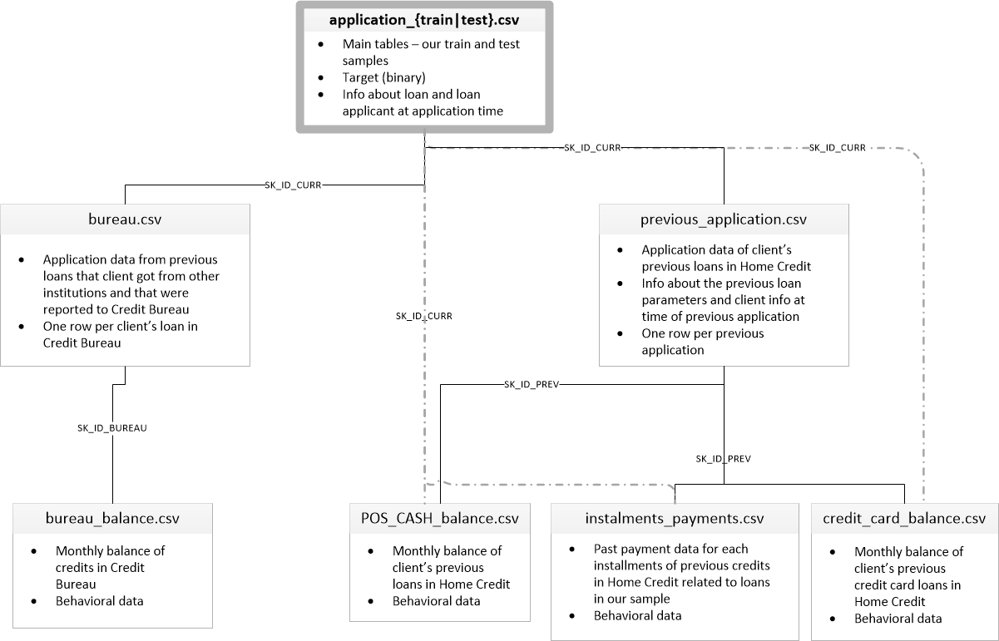

## Downloading the files via Kaggle API

Create a base directory:

```bash
DATA_DIR = "../../../Data/home-credit-default-risk"   #same level as course repo in the data directory
```

Please download the project data files and data dictionary and unzip them using either of the following approaches:

1. Click on the `Download` button on the following [Data Webpage](https://www.kaggle.com/c/home-credit-default-risk/data) and unzip the  zip file to the `BASE_DIR`
2. If you plan to use the Kaggle API, please use the following steps.


In [6]:
DATA_DIR = "/Users/nidhisaduvala/Desktop/Spring/AML/home-credit-default-risk"   #same level as course repo in the data directory
#DATA_DIR = os.path.join('./ddddd/')
!mkdir $DATA_DIR

mkdir: /Users/nidhisaduvala/Desktop/Spring/AML/home-credit-default-risk: File exists


In [7]:
!ls -l $DATA_DIR

total 5242728
-rw-rw-r--@ 1 nidhisaduvala  staff      37383 Dec 11  2019 HomeCredit_columns_description.csv
-rw-rw-r--@ 1 nidhisaduvala  staff  392703158 Dec 11  2019 POS_CASH_balance.csv
-rw-rw-r--@ 1 nidhisaduvala  staff   26567651 Dec 11  2019 application_test.csv
-rw-rw-r--@ 1 nidhisaduvala  staff  166133370 Dec 11  2019 application_train.csv
-rw-rw-r--@ 1 nidhisaduvala  staff  170016717 Dec 11  2019 bureau.csv
-rw-rw-r--@ 1 nidhisaduvala  staff  375592889 Dec 11  2019 bureau_balance.csv
-rw-rw-r--@ 1 nidhisaduvala  staff  424582605 Dec 11  2019 credit_card_balance.csv
-rw-rw-r--@ 1 nidhisaduvala  staff  723118349 Dec 11  2019 installments_payments.csv
-rw-rw-r--@ 1 nidhisaduvala  staff  404973293 Dec 11  2019 previous_application.csv
-rw-rw-r--@ 1 nidhisaduvala  staff     536202 Dec 11  2019 sample_submission.csv


In [8]:
! kaggle competitions download home-credit-default-risk -p $DATA_DIR

Traceback (most recent call last):
  File "/Users/nidhisaduvala/opt/anaconda3/bin/kaggle", line 5, in <module>
    from kaggle.cli import main
  File "/Users/nidhisaduvala/opt/anaconda3/lib/python3.8/site-packages/kaggle/__init__.py", line 23, in <module>
    api.authenticate()
  File "/Users/nidhisaduvala/opt/anaconda3/lib/python3.8/site-packages/kaggle/api/kaggle_api_extended.py", line 164, in authenticate
    raise IOError('Could not find {}. Make sure it\'s located in'
OSError: Could not find kaggle.json. Make sure it's located in /Users/nidhisaduvala/.kaggle. Or use the environment method.


### Imports

In [9]:
import numpy as np
import pandas as pd 
from sklearn.preprocessing import LabelEncoder
import os
import zipfile
from sklearn.base import BaseEstimator, TransformerMixin
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import MinMaxScaler
from sklearn.pipeline import Pipeline, FeatureUnion
from pandas.plotting import scatter_matrix
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import OneHotEncoder
import warnings
warnings.filterwarnings('ignore')

In [10]:
unzippingReq = False
if unzippingReq: #please modify this code 
    zip_ref = zipfile.ZipFile('application_train.csv.zip', 'r')
    zip_ref.extractall('datasets')
    zip_ref.close()
    zip_ref = zipfile.ZipFile('application_test.csv.zip', 'r')
    zip_ref.extractall('datasets')
    zip_ref.close()
    zip_ref = zipfile.ZipFile('bureau_balance.csv.zip', 'r')
    zip_ref.extractall('datasets')
    zip_ref.close()
    zip_ref = zipfile.ZipFile('bureau.csv.zip', 'r')
    zip_ref.extractall('datasets')
    zip_ref.close()
    zip_ref = zipfile.ZipFile('credit_card_balance.csv.zip', 'r')
    zip_ref.extractall('datasets')
    zip_ref.close()
    zip_ref = zipfile.ZipFile('installments_payments.csv.zip', 'r')
    zip_ref.extractall('datasets')
    zip_ref.close()
    zip_ref = zipfile.ZipFile('POS_CASH_balance.csv.zip', 'r')
    zip_ref.extractall('datasets')
    zip_ref.close()
    zip_ref = zipfile.ZipFile('previous_application.csv.zip', 'r')
    zip_ref.extractall('datasets')
    zip_ref.close()

## Data files overview
### Data Dictionary

As part of the data download comes a  Data Dictionary. It named `HomeCredit_columns_description.csv`

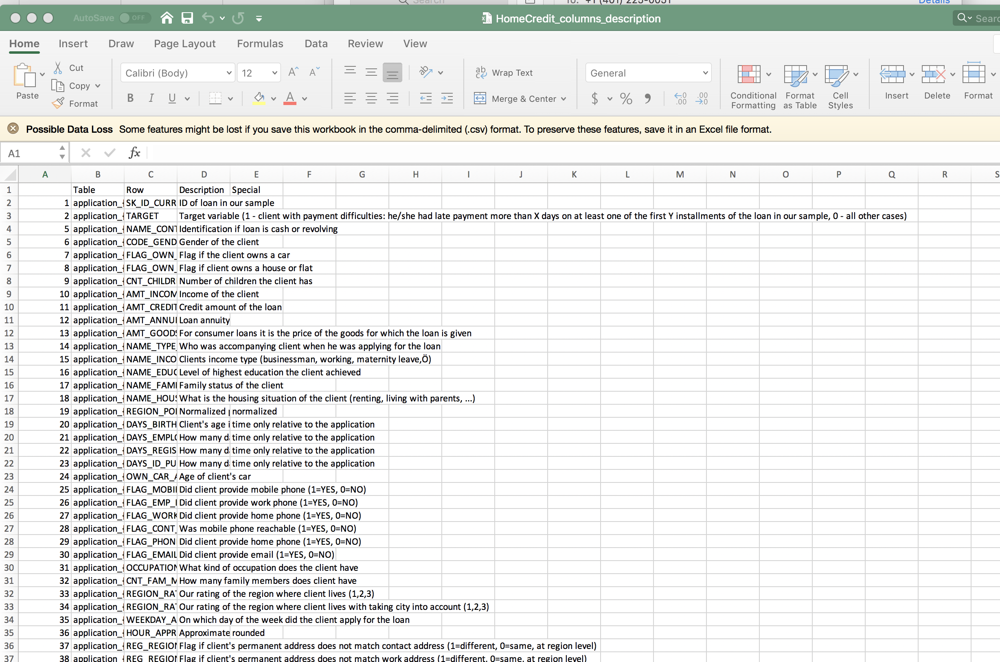

### Application train

In [11]:
import numpy as np
import pandas as pd 
from sklearn.preprocessing import LabelEncoder
import os
import zipfile
from sklearn.base import BaseEstimator, TransformerMixin
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import MinMaxScaler
from sklearn.pipeline import Pipeline, FeatureUnion
from pandas.plotting import scatter_matrix
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import OneHotEncoder
import warnings
warnings.filterwarnings('ignore')

def load_data(in_path, name):
    df = pd.read_csv(in_path)
    print(f"{name}: shape is {df.shape}")
    print(df.info())
    display(df.head(5))
    return df

datasets={}  # lets store the datasets in a dictionary so we can keep track of them easily
ds_name = 'application_train'
datasets[ds_name] = load_data(os.path.join(DATA_DIR, f'{ds_name}.csv'), ds_name)

datasets['application_train'].shape

application_train: shape is (307511, 122)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Columns: 122 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(65), int64(41), object(16)
memory usage: 286.2+ MB
None


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


(307511, 122)

### Application test


* __application_train/application_test:__ the main training and testing data with information about each loan application at Home Credit. Every loan has its own row and is identified by the feature SK_ID_CURR. The training application data comes with the TARGET indicating __0: the loan was repaid__ or __1: the loan was not repaid__. The target variable defines if the client had payment difficulties meaning he/she had late payment more than X days on at least one of the first Y installments of the loan. Such case is marked as 1 while other all other cases as 0.


In [12]:
ds_name = 'application_test'
datasets[ds_name] = load_data(os.path.join(DATA_DIR, f'{ds_name}.csv'), ds_name)

application_test: shape is (48744, 121)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Columns: 121 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(65), int64(40), object(16)
memory usage: 45.0+ MB
None


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100001,Cash loans,F,N,Y,0,135000.0,568800.0,20560.5,450000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
1,100005,Cash loans,M,N,Y,0,99000.0,222768.0,17370.0,180000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
2,100013,Cash loans,M,Y,Y,0,202500.0,663264.0,69777.0,630000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,1.0,4.0
3,100028,Cash loans,F,N,Y,2,315000.0,1575000.0,49018.5,1575000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
4,100038,Cash loans,M,Y,N,1,180000.0,625500.0,32067.0,625500.0,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN


The application dataset has the most information about the client: Gender, income, family status, education ...

### The Other datasets

* __bureau:__ data concerning client's previous credits from other financial institutions. Each previous credit has its own row in bureau, but one loan in the application data can have multiple previous credits.
* __bureau_balance:__ monthly data about the previous credits in bureau. Each row is one month of a previous credit, and a single previous credit can have multiple rows, one for each month of the credit length.
* __previous_application:__ previous applications for loans at Home Credit of clients who have loans in the application data. Each current loan in the application data can have multiple previous loans. Each previous application has one row and is identified by the feature SK_ID_PREV.
* __POS_CASH_BALANCE:__ monthly data about previous point of sale or cash loans clients have had with Home Credit. Each row is one month of a previous point of sale or cash loan, and a single previous loan can have many rows.
* credit_card_balance: monthly data about previous credit cards clients have had with Home Credit. Each row is one month of a credit card balance, and a single credit card can have many rows.
* __installments_payment:__ payment history for previous loans at Home Credit. There is one row for every made payment and one row for every missed payment.

In [13]:
%%time
ds_names = ("application_train", "application_test", "bureau","bureau_balance","credit_card_balance","installments_payments",
            "previous_application","POS_CASH_balance")

for ds_name in ds_names:
    datasets[ds_name] = load_data(os.path.join(DATA_DIR, f'{ds_name}.csv'), ds_name)


application_train: shape is (307511, 122)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Columns: 122 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(65), int64(41), object(16)
memory usage: 286.2+ MB
None


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


application_test: shape is (48744, 121)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Columns: 121 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(65), int64(40), object(16)
memory usage: 45.0+ MB
None


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100001,Cash loans,F,N,Y,0,135000.0,568800.0,20560.5,450000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
1,100005,Cash loans,M,N,Y,0,99000.0,222768.0,17370.0,180000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
2,100013,Cash loans,M,Y,Y,0,202500.0,663264.0,69777.0,630000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,1.0,4.0
3,100028,Cash loans,F,N,Y,2,315000.0,1575000.0,49018.5,1575000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
4,100038,Cash loans,M,Y,N,1,180000.0,625500.0,32067.0,625500.0,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN


bureau: shape is (1716428, 17)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1716428 entries, 0 to 1716427
Data columns (total 17 columns):
 #   Column                  Dtype  
---  ------                  -----  
 0   SK_ID_CURR              int64  
 1   SK_ID_BUREAU            int64  
 2   CREDIT_ACTIVE           object 
 3   CREDIT_CURRENCY         object 
 4   DAYS_CREDIT             int64  
 5   CREDIT_DAY_OVERDUE      int64  
 6   DAYS_CREDIT_ENDDATE     float64
 7   DAYS_ENDDATE_FACT       float64
 8   AMT_CREDIT_MAX_OVERDUE  float64
 9   CNT_CREDIT_PROLONG      int64  
 10  AMT_CREDIT_SUM          float64
 11  AMT_CREDIT_SUM_DEBT     float64
 12  AMT_CREDIT_SUM_LIMIT    float64
 13  AMT_CREDIT_SUM_OVERDUE  float64
 14  CREDIT_TYPE             object 
 15  DAYS_CREDIT_UPDATE      int64  
 16  AMT_ANNUITY             float64
dtypes: float64(8), int64(6), object(3)
memory usage: 222.6+ MB
None


,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,AMT_ANNUITY
0,215354,5714462,Closed,currency 1,-497,0,-153.0,-153.0,NaN,0,91323.0,0.0,NaN,0.0,Consumer credit,-131,NaN
1,215354,5714463,Active,currency 1,-208,0,1075.0,NaN,NaN,0,225000.0,171342.0,NaN,0.0,Credit card,-20,NaN
2,215354,5714464,Active,currency 1,-203,0,528.0,NaN,NaN,0,464323.5,NaN,NaN,0.0,Consumer credit,-16,NaN
3,215354,5714465,Active,currency 1,-203,0,NaN,NaN,NaN,0,90000.0,NaN,NaN,0.0,Credit card,-16,NaN
4,215354,5714466,Active,currency 1,-629,0,1197.0,NaN,77674.5,0,2700000.0,NaN,NaN,0.0,Consumer credit,-21,NaN


bureau_balance: shape is (27299925, 3)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27299925 entries, 0 to 27299924
Data columns (total 3 columns):
 #   Column          Dtype 
---  ------          ----- 
 0   SK_ID_BUREAU    int64 
 1   MONTHS_BALANCE  int64 
 2   STATUS          object
dtypes: int64(2), object(1)
memory usage: 624.8+ MB
None


,SK_ID_BUREAU,MONTHS_BALANCE,STATUS
0,5715448,0,C
1,5715448,-1,C
2,5715448,-2,C
3,5715448,-3,C
4,5715448,-4,C


credit_card_balance: shape is (3840312, 23)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3840312 entries, 0 to 3840311
Data columns (total 23 columns):
 #   Column                      Dtype  
---  ------                      -----  
 0   SK_ID_PREV                  int64  
 1   SK_ID_CURR                  int64  
 2   MONTHS_BALANCE              int64  
 3   AMT_BALANCE                 float64
 4   AMT_CREDIT_LIMIT_ACTUAL     int64  
 5   AMT_DRAWINGS_ATM_CURRENT    float64
 6   AMT_DRAWINGS_CURRENT        float64
 7   AMT_DRAWINGS_OTHER_CURRENT  float64
 8   AMT_DRAWINGS_POS_CURRENT    float64
 9   AMT_INST_MIN_REGULARITY     float64
 10  AMT_PAYMENT_CURRENT         float64
 11  AMT_PAYMENT_TOTAL_CURRENT   float64
 12  AMT_RECEIVABLE_PRINCIPAL    float64
 13  AMT_RECIVABLE               float64
 14  AMT_TOTAL_RECEIVABLE        float64
 15  CNT_DRAWINGS_ATM_CURRENT    float64
 16  CNT_DRAWINGS_CURRENT        int64  
 17  CNT_DRAWINGS_OTHER_CURRENT  float64
 18  CNT_DRAWINGS_POS_C

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,AMT_BALANCE,AMT_CREDIT_LIMIT_ACTUAL,AMT_DRAWINGS_ATM_CURRENT,AMT_DRAWINGS_CURRENT,AMT_DRAWINGS_OTHER_CURRENT,AMT_DRAWINGS_POS_CURRENT,AMT_INST_MIN_REGULARITY,...,AMT_RECIVABLE,AMT_TOTAL_RECEIVABLE,CNT_DRAWINGS_ATM_CURRENT,CNT_DRAWINGS_CURRENT,CNT_DRAWINGS_OTHER_CURRENT,CNT_DRAWINGS_POS_CURRENT,CNT_INSTALMENT_MATURE_CUM,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,2562384,378907,-6,56.970,135000,0.0,877.5,0.0,877.5,1700.325,...,0.000,0.000,0.0,1,0.0,1.0,35.0,Active,0,0
1,2582071,363914,-1,63975.555,45000,2250.0,2250.0,0.0,0.0,2250.000,...,64875.555,64875.555,1.0,1,0.0,0.0,69.0,Active,0,0
2,1740877,371185,-7,31815.225,450000,0.0,0.0,0.0,0.0,2250.000,...,31460.085,31460.085,0.0,0,0.0,0.0,30.0,Active,0,0
3,1389973,337855,-4,236572.110,225000,2250.0,2250.0,0.0,0.0,11795.760,...,233048.970,233048.970,1.0,1,0.0,0.0,10.0,Active,0,0
4,1891521,126868,-1,453919.455,450000,0.0,11547.0,0.0,11547.0,22924.890,...,453919.455,453919.455,0.0,1,0.0,1.0,101.0,Active,0,0


installments_payments: shape is (13605401, 8)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13605401 entries, 0 to 13605400
Data columns (total 8 columns):
 #   Column                  Dtype  
---  ------                  -----  
 0   SK_ID_PREV              int64  
 1   SK_ID_CURR              int64  
 2   NUM_INSTALMENT_VERSION  float64
 3   NUM_INSTALMENT_NUMBER   int64  
 4   DAYS_INSTALMENT         float64
 5   DAYS_ENTRY_PAYMENT      float64
 6   AMT_INSTALMENT          float64
 7   AMT_PAYMENT             float64
dtypes: float64(5), int64(3)
memory usage: 830.4 MB
None


,SK_ID_PREV,SK_ID_CURR,NUM_INSTALMENT_VERSION,NUM_INSTALMENT_NUMBER,DAYS_INSTALMENT,DAYS_ENTRY_PAYMENT,AMT_INSTALMENT,AMT_PAYMENT
0,1054186,161674,1.0,6,-1180.0,-1187.0,6948.360,6948.360
1,1330831,151639,0.0,34,-2156.0,-2156.0,1716.525,1716.525
2,2085231,193053,2.0,1,-63.0,-63.0,25425.000,25425.000
3,2452527,199697,1.0,3,-2418.0,-2426.0,24350.130,24350.130
4,2714724,167756,1.0,2,-1383.0,-1366.0,2165.040,2160.585


previous_application: shape is (1670214, 37)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1670214 entries, 0 to 1670213
Data columns (total 37 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   SK_ID_PREV                   1670214 non-null  int64  
 1   SK_ID_CURR                   1670214 non-null  int64  
 2   NAME_CONTRACT_TYPE           1670214 non-null  object 
 3   AMT_ANNUITY                  1297979 non-null  float64
 4   AMT_APPLICATION              1670214 non-null  float64
 5   AMT_CREDIT                   1670213 non-null  float64
 6   AMT_DOWN_PAYMENT             774370 non-null   float64
 7   AMT_GOODS_PRICE              1284699 non-null  float64
 8   WEEKDAY_APPR_PROCESS_START   1670214 non-null  object 
 9   HOUR_APPR_PROCESS_START      1670214 non-null  int64  
 10  FLAG_LAST_APPL_PER_CONTRACT  1670214 non-null  object 
 11  NFLAG_LAST_APPL_IN_DAY       1670214 non-null  int64  
 1

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,...,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,0.0,17145.0,SATURDAY,15,...,Connectivity,12.0,middle,POS mobile with interest,365243.0,-42.0,300.0,-42.0,-37.0,0.0
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,NaN,607500.0,THURSDAY,11,...,XNA,36.0,low_action,Cash X-Sell: low,365243.0,-134.0,916.0,365243.0,365243.0,1.0
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,NaN,112500.0,TUESDAY,11,...,XNA,12.0,high,Cash X-Sell: high,365243.0,-271.0,59.0,365243.0,365243.0,1.0
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,NaN,450000.0,MONDAY,7,...,XNA,12.0,middle,Cash X-Sell: middle,365243.0,-482.0,-152.0,-182.0,-177.0,1.0
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,NaN,337500.0,THURSDAY,9,...,XNA,24.0,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


POS_CASH_balance: shape is (10001358, 8)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10001358 entries, 0 to 10001357
Data columns (total 8 columns):
 #   Column                 Dtype  
---  ------                 -----  
 0   SK_ID_PREV             int64  
 1   SK_ID_CURR             int64  
 2   MONTHS_BALANCE         int64  
 3   CNT_INSTALMENT         float64
 4   CNT_INSTALMENT_FUTURE  float64
 5   NAME_CONTRACT_STATUS   object 
 6   SK_DPD                 int64  
 7   SK_DPD_DEF             int64  
dtypes: float64(2), int64(5), object(1)
memory usage: 610.4+ MB
None


,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT,CNT_INSTALMENT_FUTURE,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,1803195,182943,-31,48.0,45.0,Active,0,0
1,1715348,367990,-33,36.0,35.0,Active,0,0
2,1784872,397406,-32,12.0,9.0,Active,0,0
3,1903291,269225,-35,48.0,42.0,Active,0,0
4,2341044,334279,-35,36.0,35.0,Active,0,0


CPU times: user 22.9 s, sys: 3.08 s, total: 26 s
Wall time: 26.9 s


In [14]:
for ds_name in datasets.keys():
    print(f'dataset {ds_name:24}: [ {datasets[ds_name].shape[0]:10,}, {datasets[ds_name].shape[1]}]')


dataset application_train       : [    307,511, 122]
dataset application_test        : [     48,744, 121]
dataset bureau                  : [  1,716,428, 17]
dataset bureau_balance          : [ 27,299,925, 3]
dataset credit_card_balance     : [  3,840,312, 23]
dataset installments_payments   : [ 13,605,401, 8]
dataset previous_application    : [  1,670,214, 37]
dataset POS_CASH_balance        : [ 10,001,358, 8]


## Exploratory Data Analysis

#### Descriptive statistics

● A data dictionary of the raw features. <br>
●  Pandas profiling in jupyter notebook. <br>
● We did descriptive analysis on the dataset such as data type of each feature, dataset size (rows and columns = 307511, 122), and summary statistics such as the number of observations, mean, standard deviation, maximum, minimum, and quartiles for all features and split of data is as follows Train: 70%, Test 20%, Validation 10%. <br>
● We generated charts on descriptive statistics of the target dataset. <br>

## Summary of Application train

In [28]:
application_test = pd.read_csv('/Users/nidhisaduvala/Desktop/Spring/AML/home-credit-default-risk/application_test.csv')
application_train = pd.read_csv('/Users/nidhisaduvala/Desktop/Spring/AML/home-credit-default-risk/application_train.csv')

In [29]:
def EDA(df,df_name):
    print("Test description; data type: {}".format(df_name))
    print(df.dtypes)
    print("\n##########################################################\n")
    print(" Dataset size (rows columns): {}".format(df_name))
    print(df.shape)
    print("\n##########################################################\n")
    print("Summary statistics: {}".format(df_name))
    print(df.describe())
    print("\n##########################################################\n")
    print("Correlation analysis: {}".format(df_name))
    print(df.corr())
    print("\n##########################################################\n")
    print("Other Analysis: {}".format(df_name))
    print("1. Checking for Null values: {}".format(df_name))
    print(df.isna().sum())
    print("\n2. Info")
    print(df.info())

In [33]:
EDA(datasets['application_train'],'application_train')

Test description; data type: application_train
SK_ID_CURR                      int64
TARGET                          int64
NAME_CONTRACT_TYPE             object
CODE_GENDER                    object
FLAG_OWN_CAR                   object
                               ...   
AMT_REQ_CREDIT_BUREAU_DAY     float64
AMT_REQ_CREDIT_BUREAU_WEEK    float64
AMT_REQ_CREDIT_BUREAU_MON     float64
AMT_REQ_CREDIT_BUREAU_QRT     float64
AMT_REQ_CREDIT_BUREAU_YEAR    float64
Length: 122, dtype: object

##########################################################

 Dataset size (rows columns): application_train
(307511, 122)

##########################################################

Summary statistics: application_train
          SK_ID_CURR         TARGET   CNT_CHILDREN  AMT_INCOME_TOTAL  \
count  307511.000000  307511.000000  307511.000000      3.075110e+05   
mean   278180.518577       0.080729       0.417052      1.687979e+05   
std    102790.175348       0.272419       0.722121      2.371231e+05  

In [15]:
datasets["application_train"].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Columns: 122 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(65), int64(41), object(16)
memory usage: 286.2+ MB


In [16]:
datasets["application_train"].describe() #numerical only features

,SK_ID_CURR,TARGET,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
count,307511.000000,307511.000000,307511.000000,3.075110e+05,3.075110e+05,307499.000000,3.072330e+05,307511.000000,307511.000000,307511.000000,...,307511.000000,307511.000000,307511.000000,307511.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000
mean,278180.518577,0.080729,0.417052,1.687979e+05,5.990260e+05,27108.573909,5.383962e+05,0.020868,-16036.995067,63815.045904,...,0.008130,0.000595,0.000507,0.000335,0.006402,0.007000,0.034362,0.267395,0.265474,1.899974
std,102790.175348,0.272419,0.722121,2.371231e+05,4.024908e+05,14493.737315,3.694465e+05,0.013831,4363.988632,141275.766519,...,0.089798,0.024387,0.022518,0.018299,0.083849,0.110757,0.204685,0.916002,0.794056,1.869295
min,100002.000000,0.000000,0.000000,2.565000e+04,4.500000e+04,1615.500000,4.050000e+04,0.000290,-25229.000000,-17912.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,189145.500000,0.000000,0.000000,1.125000e+05,2.700000e+05,16524.000000,2.385000e+05,0.010006,-19682.000000,-2760.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,278202.000000,0.000000,0.000000,1.471500e+05,5.135310e+05,24903.000000,4.500000e+05,0.018850,-15750.000000,-1213.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
75%,367142.500000,0.000000,1.000000,2.025000e+05,8.086500e+05,34596.000000,6.795000e+05,0.028663,-12413.000000,-289.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000
max,456255.000000,1.000000,19.000000,1.170000e+08,4.050000e+06,258025.500000,4.050000e+06,0.072508,-7489.000000,365243.000000,...,1.000000,1.000000,1.000000,1.000000,4.000000,9.000000,8.000000,27.000000,261.000000,25.000000


In [17]:
datasets["application_test"].describe() #numerical only features

,SK_ID_CURR,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
count,48744.000000,48744.000000,4.874400e+04,4.874400e+04,48720.000000,4.874400e+04,48744.000000,48744.000000,48744.000000,48744.000000,...,48744.000000,48744.0,48744.0,48744.0,42695.000000,42695.000000,42695.000000,42695.000000,42695.000000,42695.000000
mean,277796.676350,0.397054,1.784318e+05,5.167404e+05,29426.240209,4.626188e+05,0.021226,-16068.084605,67485.366322,-4967.652716,...,0.001559,0.0,0.0,0.0,0.002108,0.001803,0.002787,0.009299,0.546902,1.983769
std,103169.547296,0.709047,1.015226e+05,3.653970e+05,16016.368315,3.367102e+05,0.014428,4325.900393,144348.507136,3552.612035,...,0.039456,0.0,0.0,0.0,0.046373,0.046132,0.054037,0.110924,0.693305,1.838873
min,100001.000000,0.000000,2.694150e+04,4.500000e+04,2295.000000,4.500000e+04,0.000253,-25195.000000,-17463.000000,-23722.000000,...,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,188557.750000,0.000000,1.125000e+05,2.606400e+05,17973.000000,2.250000e+05,0.010006,-19637.000000,-2910.000000,-7459.250000,...,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,277549.000000,0.000000,1.575000e+05,4.500000e+05,26199.000000,3.960000e+05,0.018850,-15785.000000,-1293.000000,-4490.000000,...,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000
75%,367555.500000,1.000000,2.250000e+05,6.750000e+05,37390.500000,6.300000e+05,0.028663,-12496.000000,-296.000000,-1901.000000,...,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,1.000000,3.000000
max,456250.000000,20.000000,4.410000e+06,2.245500e+06,180576.000000,2.245500e+06,0.072508,-7338.000000,365243.000000,0.000000,...,1.000000,0.0,0.0,0.0,2.000000,2.000000,2.000000,6.000000,7.000000,17.000000


In [ ]:
#datasets["application_train"].describe(include='all') #look at all categorical and numerical

## Missing data for application train

In [18]:
percent = (datasets["application_train"].isnull().sum()/datasets["application_train"].isnull().count()*100).sort_values(ascending = False).round(2)
sum_missing = datasets["application_train"].isna().sum().sort_values(ascending = False)
missing_application_train_data  = pd.concat([percent, sum_missing], axis=1, keys=['Percent', "Train Missing Count"])
missing_application_train_data.head(20)

,Percent,Train Missing Count
COMMONAREA_MEDI,69.87,214865
COMMONAREA_AVG,69.87,214865
COMMONAREA_MODE,69.87,214865
NONLIVINGAPARTMENTS_MODE,69.43,213514
NONLIVINGAPARTMENTS_AVG,69.43,213514
NONLIVINGAPARTMENTS_MEDI,69.43,213514
FONDKAPREMONT_MODE,68.39,210295
LIVINGAPARTMENTS_MODE,68.35,210199
LIVINGAPARTMENTS_AVG,68.35,210199
LIVINGAPARTMENTS_MEDI,68.35,210199


In [19]:
percent = (datasets["application_test"].isnull().sum()/datasets["application_test"].isnull().count()*100).sort_values(ascending = False).round(2)
sum_missing = datasets["application_test"].isna().sum().sort_values(ascending = False)
missing_application_train_data  = pd.concat([percent, sum_missing], axis=1, keys=['Percent', "Test Missing Count"])
missing_application_train_data.head(20)

,Percent,Test Missing Count
COMMONAREA_AVG,68.72,33495
COMMONAREA_MODE,68.72,33495
COMMONAREA_MEDI,68.72,33495
NONLIVINGAPARTMENTS_AVG,68.41,33347
NONLIVINGAPARTMENTS_MODE,68.41,33347
NONLIVINGAPARTMENTS_MEDI,68.41,33347
FONDKAPREMONT_MODE,67.28,32797
LIVINGAPARTMENTS_AVG,67.25,32780
LIVINGAPARTMENTS_MODE,67.25,32780
LIVINGAPARTMENTS_MEDI,67.25,32780


## Distribution of the target column 

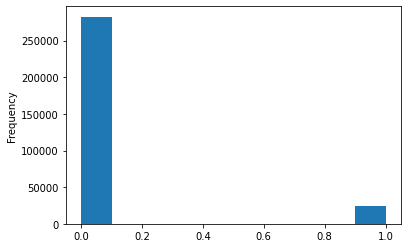

In [20]:
datasets["application_train"]['TARGET'].astype(int).plot.hist();

## Correlation with  the target column 

In [21]:
correlations = datasets["application_train"].corr()['TARGET'].sort_values()
print('Most Positive Correlations:\n', correlations.tail(10))
print('\nMost Negative Correlations:\n', correlations.head(10))

Most Positive Correlations:
 FLAG_DOCUMENT_3                0.044346
REG_CITY_NOT_LIVE_CITY         0.044395
FLAG_EMP_PHONE                 0.045982
REG_CITY_NOT_WORK_CITY         0.050994
DAYS_ID_PUBLISH                0.051457
DAYS_LAST_PHONE_CHANGE         0.055218
REGION_RATING_CLIENT           0.058899
REGION_RATING_CLIENT_W_CITY    0.060893
DAYS_BIRTH                     0.078239
TARGET                         1.000000
Name: TARGET, dtype: float64

Most Negative Correlations:
 EXT_SOURCE_3                 -0.178919
EXT_SOURCE_2                 -0.160472
EXT_SOURCE_1                 -0.155317
DAYS_EMPLOYED                -0.044932
FLOORSMAX_AVG                -0.044003
FLOORSMAX_MEDI               -0.043768
FLOORSMAX_MODE               -0.043226
AMT_GOODS_PRICE              -0.039645
REGION_POPULATION_RELATIVE   -0.037227
ELEVATORS_AVG                -0.034199
Name: TARGET, dtype: float64


## Applicants Age 

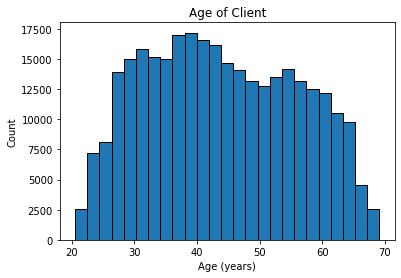

In [22]:
plt.hist(datasets["application_train"]['DAYS_BIRTH'] / -365, edgecolor = 'k', bins = 25)
plt.title('Age of Client'); plt.xlabel('Age (years)'); plt.ylabel('Count');

## Applicants occupations

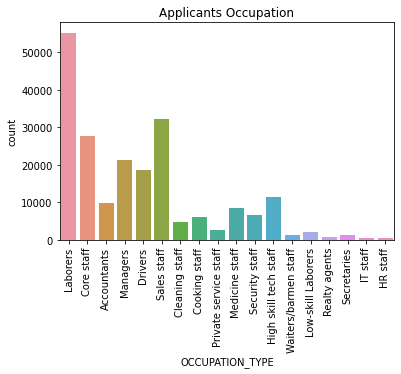

In [23]:
sns.countplot(x='OCCUPATION_TYPE', data=datasets["application_train"]);
plt.title('Applicants Occupation');
plt.xticks(rotation=90);

##  Target Vs borrowers based on gender

In [34]:
male_data = application_train[application_train['CODE_GENDER']=='M']['TARGET'].value_counts().reset_index().rename(columns={'TARGET':'user_count','index':'TARGET'})
male_data['count_percent'] = male_data['user_count']/male_data['user_count'].sum()*100
male_data['CODE_GENDER'] = 'M'
female_data = application_train[application_train['CODE_GENDER']=='F']['TARGET'].value_counts().reset_index().rename(columns={'TARGET':'user_count','index':'TARGET'})
female_data['count_percent'] = female_data['user_count']/female_data['user_count'].sum()*100
female_data['CODE_GENDER'] = 'F'
gender_data = male_data.append(female_data, ignore_index=True,sort=False)
gender_data

,TARGET,user_count,count_percent,CODE_GENDER
0,0,94404,89.858080,M
1,1,10655,10.141920,M
2,0,188278,93.000672,F
3,1,14170,6.999328,F


Text(10.772152777777777, 0.5, 'User count in Percentage')

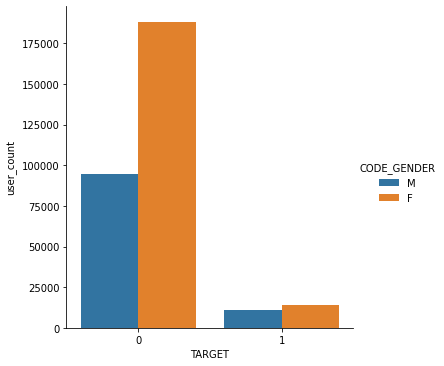

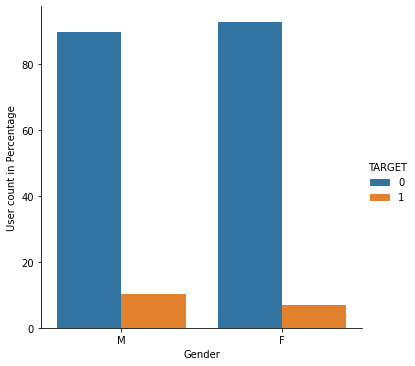

In [35]:
sns.catplot(data=gender_data, kind="bar", x="TARGET", y="user_count", hue="CODE_GENDER")
sns.catplot(data=gender_data, kind="bar", x="CODE_GENDER", y="count_percent", hue="TARGET")
plt.xlabel("Gender")
plt.ylabel('User count in Percentage')

### Male most likely to default than Female based on percentage of defaulter_count(Second Graph)


## Gender Vs Income based on Target

Text(0, 0.5, 'Annual Income')

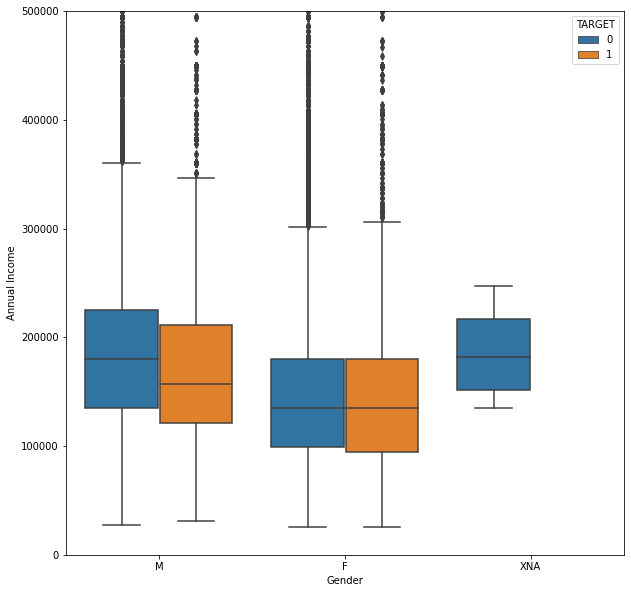

In [36]:
fig,ax = plt.subplots(figsize = (10,10))
sns.boxplot(x='CODE_GENDER',hue = 'TARGET',y='AMT_INCOME_TOTAL', data=application_train)
plt.ylim(0, 500000)
plt.xlabel("Gender")
plt.ylabel('Annual Income')


## Own House count based Target


In [37]:
own_house_data = application_train[application_train['FLAG_OWN_REALTY']=='Y']['TARGET'].value_counts().reset_index().rename(columns={'TARGET':'user_count','index':'TARGET'})
own_house_data['OWN_HOUSE'] = 'Y'
own_house_data['count_percent'] = own_house_data['user_count']/own_house_data['user_count'].sum()*100
not_own_house_data = application_train[application_train['FLAG_OWN_REALTY']=='N']['TARGET'].value_counts().reset_index().rename(columns={'TARGET':'user_count','index':'TARGET'})
not_own_house_data['OWN_HOUSE'] = 'N'
not_own_house_data['count_percent'] = not_own_house_data['user_count']/not_own_house_data['user_count'].sum()*100
own_house_data = own_house_data.append(not_own_house_data,ignore_index=True,sort=False)
own_house_data


,TARGET,user_count,OWN_HOUSE,count_percent
0,0,196329,Y,92.038423
1,1,16983,Y,7.961577
2,0,86357,N,91.675071
3,1,7842,N,8.324929


Text(10.772152777777777, 0.5, 'User count in Percentage')

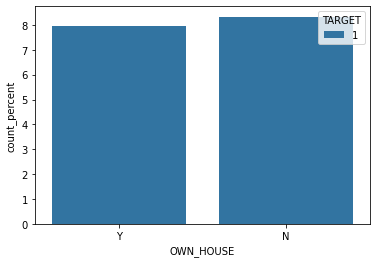

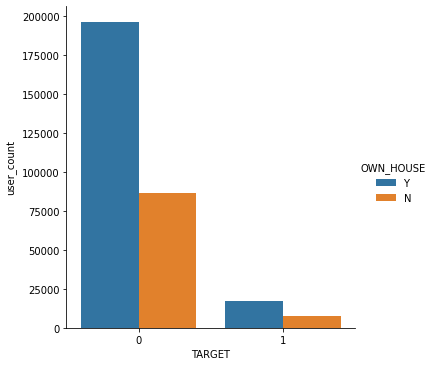

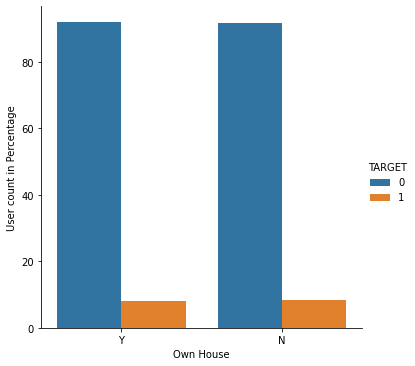

In [38]:
sns.barplot(x='OWN_HOUSE',y='count_percent',hue = 'TARGET',data=own_house_data[own_house_data['TARGET']==1])

sns.catplot(data=own_house_data, kind="bar", x="TARGET", y="user_count", hue="OWN_HOUSE")

sns.catplot(data=own_house_data, kind="bar", x="OWN_HOUSE", y="count_percent", hue="TARGET")
plt.xlabel("Own House")
plt.ylabel('User count in Percentage')


### Not a significant difference, but borrowers who own a house are more likely to pay 

## Own car count based Target

In [39]:
own_car_data = application_train[application_train['FLAG_OWN_CAR']=='Y']['TARGET'].value_counts().reset_index().rename(columns={'TARGET':'user_count','index':'TARGET'})
own_car_data['FLAG_OWN_CAR'] = 'Y'
own_car_data['count_percent'] = own_car_data['user_count']/own_car_data['user_count'].sum()*100
not_own_car_data = application_train[application_train['FLAG_OWN_CAR']=='N']['TARGET'].value_counts().reset_index().rename(columns={'TARGET':'user_count','index':'TARGET'})
not_own_car_data['FLAG_OWN_CAR'] = 'N'
not_own_car_data['count_percent'] = not_own_car_data['user_count']/not_own_car_data['user_count'].sum()*100
own_car_data = own_car_data.append(not_own_car_data,ignore_index=True,sort=False)
own_car_data

,TARGET,user_count,FLAG_OWN_CAR,count_percent
0,0,97011,Y,92.756270
1,1,7576,Y,7.243730
2,0,185675,N,91.499773
3,1,17249,N,8.500227


Text(10.772152777777777, 0.5, 'User count in Percentage')

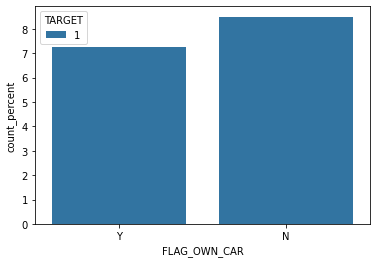

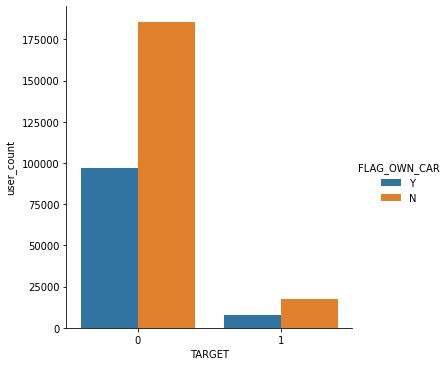

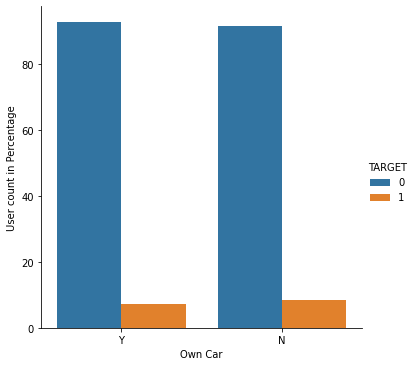

In [40]:
sns.barplot(x='FLAG_OWN_CAR',y='count_percent',hue = 'TARGET',data=own_car_data[own_car_data['TARGET']==1])

sns.catplot(data=own_car_data, kind="bar", x="TARGET", y="user_count", hue="FLAG_OWN_CAR")

sns.catplot(data=own_car_data, kind="bar", x="FLAG_OWN_CAR", y="count_percent", hue="TARGET")
plt.xlabel("Own Car")
plt.ylabel('User count in Percentage')

### Borrowers owning a car are more likely to pay on time

## Occupation type count based on Target


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17]),
 [Text(0, 0, 'Laborers'),
  Text(1, 0, 'Core staff'),
  Text(2, 0, 'Accountants'),
  Text(3, 0, 'Managers'),
  Text(4, 0, 'Drivers'),
  Text(5, 0, 'Sales staff'),
  Text(6, 0, 'Cleaning staff'),
  Text(7, 0, 'Cooking staff'),
  Text(8, 0, 'Private service staff'),
  Text(9, 0, 'Medicine staff'),
  Text(10, 0, 'Security staff'),
  Text(11, 0, 'High skill tech staff'),
  Text(12, 0, 'Waiters/barmen staff'),
  Text(13, 0, 'Low-skill Laborers'),
  Text(14, 0, 'Realty agents'),
  Text(15, 0, 'Secretaries'),
  Text(16, 0, 'IT staff'),
  Text(17, 0, 'HR staff')])

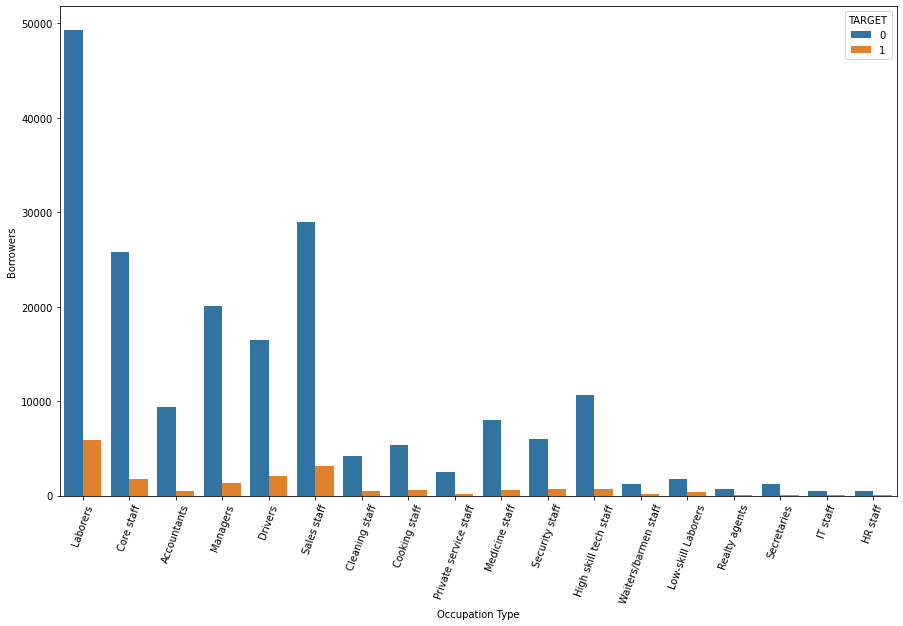

In [41]:
fig, ax = plt.subplots(figsize=(15,9))
sns.countplot(x='OCCUPATION_TYPE', hue = 'TARGET',data=application_train)
plt.xlabel("Occupation Type")
plt.ylabel('Borrowers')
plt.xticks(rotation=70)

## Occupation type vs income based on Target

Text(0, 0.5, 'Average Annual family income')

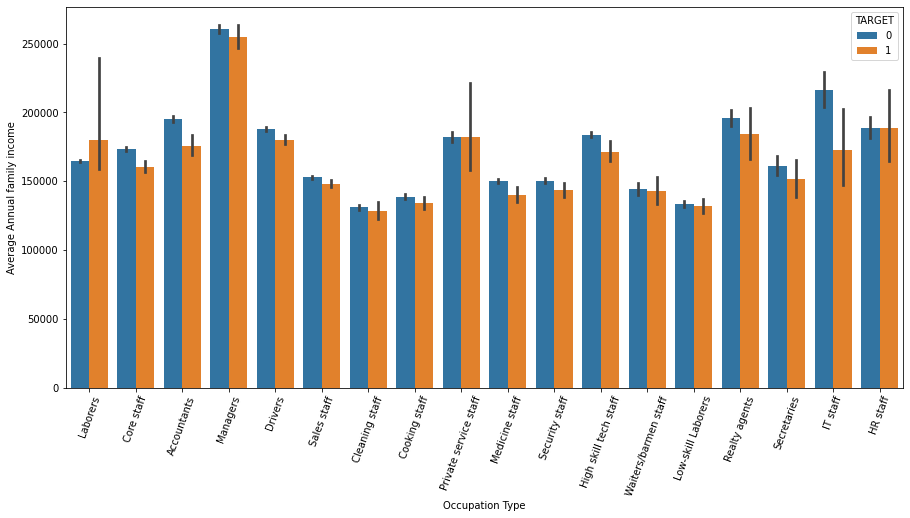

In [42]:
fig, ax = plt.subplots(figsize=(15,7))
sns.barplot(x='OCCUPATION_TYPE',y='AMT_INCOME_TOTAL',hue = 'TARGET',data=application_train)
plt.xticks(rotation=70)
plt.xlabel("Occupation Type")
plt.ylabel("Average Annual family income")


In [43]:
income_credit_ratio_data = application_train[['AMT_INCOME_TOTAL','AMT_CREDIT','TARGET']]
income_credit_ratio_data['IC_ratio'] = income_credit_ratio_data['AMT_INCOME_TOTAL']/income_credit_ratio_data['AMT_CREDIT']
income_credit_ratio_data['quantile'] = pd.qcut(income_credit_ratio_data['IC_ratio'],q = 10, labels = False)
income_credit_ratio_data

,AMT_INCOME_TOTAL,AMT_CREDIT,TARGET,IC_ratio,quantile
0,202500.0,406597.5,1,0.498036,7
1,270000.0,1293502.5,0,0.208736,2
2,67500.0,135000.0,0,0.500000,7
3,135000.0,312682.5,0,0.431748,6
4,121500.0,513000.0,0,0.236842,3
...,...,...,...,...,...
307506,157500.0,254700.0,0,0.618375,8
307507,72000.0,269550.0,0,0.267112,4
307508,153000.0,677664.0,0,0.225776,3
307509,171000.0,370107.0,1,0.462029,7


In [44]:
income_credit_ratio_data = income_credit_ratio_data.groupby(['quantile','TARGET'])['AMT_INCOME_TOTAL'].count().reset_index().rename(columns={'AMT_INCOME_TOTAL':'user_count'})
income_credit_ratio_data['count_percent'] = income_credit_ratio_data.apply(lambda x: x['user_count']/income_credit_ratio_data[income_credit_ratio_data['quantile']==x['quantile']]['user_count'].sum()*100,axis=1)
income_credit_ratio_data

,quantile,TARGET,user_count,count_percent
0,0,0,28613,92.929523
1,0,1,2177,7.070477
2,1,0,28499,92.577313
3,1,1,2285,7.422687
4,2,0,28241,92.035196
5,2,1,2444,7.964804
6,3,0,28128,91.375110
7,3,1,2655,8.624890
8,4,0,27899,90.805234
9,4,1,2825,9.194766


Text(0, 0.5, 'defaulter/Non-defaulter percentage')

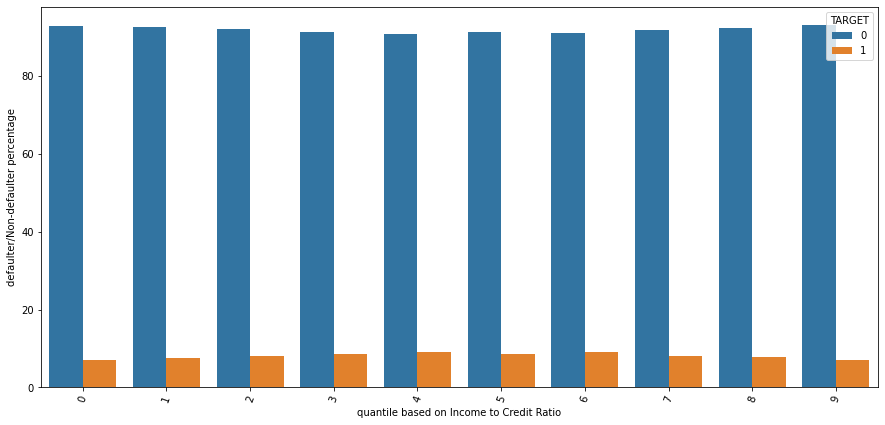

In [45]:
fig, ax = plt.subplots(figsize=(15,7))
sns.barplot(x='quantile',y='count_percent',hue = 'TARGET',data=income_credit_ratio_data)
plt.xticks(rotation=70)
plt.xlabel("quantile based on Income to Credit Ratio")
plt.ylabel("defaulter/Non-defaulter percentage")

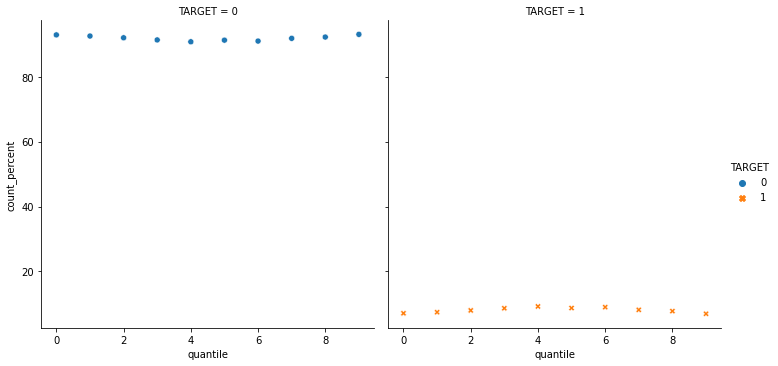

In [46]:
sns.relplot(
    data=income_credit_ratio_data, x="quantile", y="count_percent",
    col="TARGET", hue="TARGET", style="TARGET",
    kind="scatter"
)

### Defaulters percentage is less when IC_ratio is either Low or High

## Repayers to Applicants Ratio

In [47]:
occ_data = pd.DataFrame(data=application_train.groupby(['OCCUPATION_TYPE','TARGET']).count()['SK_ID_CURR'])
occ_data = occ_data.reset_index() 
value_counts = occ_data['SK_ID_CURR'].values
def repayers_to_applicants_ratio(values):
    flag = 1
    ratios = []
    for count in range(len(values)):
        if flag == 1:
            current_number = values[count]
            next_number = values[count+1]
            ratios.append(current_number/(current_number+next_number))
            ratios.append(current_number/(current_number+next_number))
        flag=flag*-1
    return ratios
occ_data['Ratio R/A'] = repayers_to_applicants_ratio(value_counts)
occ_ratio = occ_data.groupby(['OCCUPATION_TYPE','Ratio R/A']).count().drop(['TARGET', 'SK_ID_CURR'],axis=1)
occ_ratio = occ_ratio.reset_index() 
occ_ratio = occ_ratio.sort_values(['Ratio R/A'],ascending=False)
occ_ratio

,OCCUPATION_TYPE,Ratio R/A
0,Accountants,0.951697
6,High skill tech staff,0.938401
10,Managers,0.937860
3,Core staff,0.936960
5,HR staff,0.936057
7,IT staff,0.935361
12,Private service staff,0.934012
11,Medicine staff,0.932998
15,Secretaries,0.929502
13,Realty agents,0.921438


## Correlation of the positive days since birth and target

In [48]:
# Find the correlation of the positive days since birth and target
application_train['DAYS_BIRTH'] = abs(application_train['DAYS_BIRTH'])
-1*(application_train['DAYS_BIRTH'].corr(application_train['TARGET']))

0.07823930830982737

## Correlation of the positive days since employement and target

In [49]:
application_train['DAYS_EMPLOYED'] = abs(application_train['DAYS_EMPLOYED'])
-1*(application_train['DAYS_EMPLOYED'].corr(application_train['TARGET']))

0.04704582521599308

### Fetching important releavant features

In [50]:
imp_features = ['FLOORSMAX_MEDI', 'ELEVATORS_MEDI', 'AMT_GOODS_PRICE', 'EMERGENCYSTATE_MODE', 'NAME_TYPE_SUITE', 'YEARS_BEGINEXPLUATATION_MEDI', 'BASEMENTAREA_MEDI', 'FLAG_DOCUMENT_3', 'AMT_ANNUITY', 'BASEMENTAREA_MODE', 'FLAG_DOCUMENT_6', 'FLAG_DOCUMENT_4', 'FLAG_OWN_CAR', 'FONDKAPREMONT_MODE', 'FLAG_OWN_REALTY', 'ENTRANCES_MEDI', 'NONLIVINGAPARTMENTS_AVG', 'APARTMENTS_MODE', 'DAYS_REGISTRATION', 'YEARS_BUILD_AVG']
imp_features = ['CODE_GENDER','FLAG_OWN_REALTY','FLAG_OWN_CAR','AMT_CREDIT','AMT_ANNUITY','DAYS_EMPLOYED','OWN_CAR_AGE','OCCUPATION_TYPE','CNT_FAM_MEMBERS','EXT_SOURCE_1','EXT_SOURCE_2','EXT_SOURCE_3'] + imp_features + ['TARGET']
imp_features = list(set(imp_features))

## Pandas profiling (contains correlation graphs between features)

In [52]:
from pandas_profiling import ProfileReport
profile = ProfileReport(application_train[imp_features], title='HomeCredit Dataset Pandas Profiling Report', explorative = True)

In [53]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# Dataset questions
## Unique record for each SK_ID_CURR

In [54]:
datasets.keys()

dict_keys(['application_train', 'application_test', 'bureau', 'bureau_balance', 'credit_card_balance', 'installments_payments', 'previous_application', 'POS_CASH_balance'])

In [55]:
len(datasets["application_train"]["SK_ID_CURR"].unique()) == datasets["application_train"].shape[0]

True

In [56]:
np.intersect1d(datasets["application_train"]["SK_ID_CURR"], datasets["application_test"]["SK_ID_CURR"])

array([], dtype=int64)

In [57]:
datasets["application_test"].shape

(48744, 121)

In [58]:
datasets["application_train"].shape

(307511, 122)

## previous applications for the submission file
The persons in the kaggle submission file have had previous applications in the `previous_application.csv`. 47,800 out 48,744 people have had previous appications.

In [64]:
#appsDF.shape()

In [65]:
appsDF = datasets["previous_application"]

In [66]:
len(np.intersect1d(datasets["previous_application"]["SK_ID_CURR"], datasets["application_test"]["SK_ID_CURR"]))

47800

In [67]:
print(f"There are  {appsDF.shape[0]:,} previous applications")

There are  1,670,214 previous applications


In [68]:
# How many entries are there for each month?
prevAppCounts = appsDF['SK_ID_CURR'].value_counts(dropna=False)


In [69]:
len(prevAppCounts[prevAppCounts >40])  #more that 40 previous applications

101

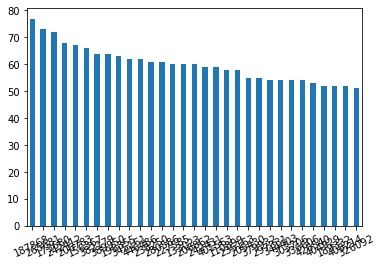

In [70]:
prevAppCounts[prevAppCounts >50].plot(kind='bar')
plt.xticks(rotation=25)
plt.show()

### Histogram of Number of previous applications for an ID

In [71]:
sum(appsDF['SK_ID_CURR'].value_counts()==1)

60458

Text(0.5, 1.0, 'Histogram of Number of previous applications for an ID')

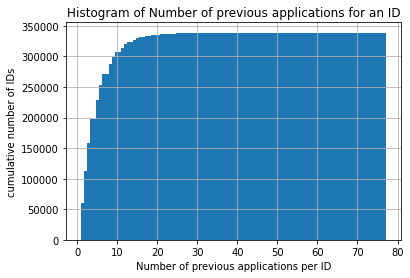

In [72]:
plt.hist(appsDF['SK_ID_CURR'].value_counts(), cumulative =True, bins = 100);
plt.grid()
plt.ylabel('cumulative number of IDs')
plt.xlabel('Number of previous applications per ID')
plt.title('Histogram of Number of previous applications for an ID')


##### **Can we differentiate applications by low, medium and high previous apps?**
    * Low = <5 claims (22%)
    * Medium = 10 to 39 claims (58%)
    * High = 40 or more claims (20%)

In [73]:
apps_all = appsDF['SK_ID_CURR'].nunique()
apps_5plus = appsDF['SK_ID_CURR'].value_counts()>=5
apps_40plus = appsDF['SK_ID_CURR'].value_counts()>=40
print('Percentage with 10 or more previous apps:', np.round(100.*(sum(apps_5plus)/apps_all),5))
print('Percentage with 40 or more previous apps:', np.round(100.*(sum(apps_40plus)/apps_all),5))

Percentage with 10 or more previous apps: 41.76895
Percentage with 40 or more previous apps: 0.03453


# Joining secondary tables with the primary table

In the case of the HCDR competition (and many other machine learning problems that involve multiple tables in 3NF or not)  we need to join these datasets (denormalize) when using a machine learning pipeline. Joining the secondary tables with the primary table will lead to lots of new features about each loan application; these features will tend to be aggregate type features or meta data about the loan or its application. How can we do this when using Machine Learning Pipelines?

## Joining `previous_application` with `application_x`
We refer to the `application_train` data (and also `application_test` data also) as the **primary table** and the other files as the **secondary tables** (e.g., `previous_application` dataset). All tables can be joined using the primary key `SK_ID_PREV`.

Let's assume we wish to generate a feature based on previous application attempts. In this case, possible features here could be:

* A simple feature could be the number of previous applications.
* Other summary features of original features such as `AMT_APPLICATION`, `AMT_CREDIT` could be based on average, min, max, median, etc.
 
To build such features, we need to join the `application_train` data (and also `application_test` data also) with the 'previous_application' dataset (and the other available datasets).

When joining this data in the context of pipelines, different strategies come to mind with various tradeoffs:

1. Preprocess each of the non-application data sets, thereby generating many new (derived) features, and then joining (aka merge) the results with the `application_train` data (the labeled dataset) and with the `application_test` data (the unlabeled submission dataset) prior to processing the data (in a train, valid, test partition) via your machine learning pipeline. [This approach is recommended for this HCDR competition. WHY?]

* Do the joins as part of the transformation steps. [Not recommended here. WHY?]. How can this be done? Will it work?
  * This would be necessary if we had dataset wide features such as IDF (inverse document frequency) which depend on the entire subset of data as opposed to a single loan application (e.g., a feature about the relative amount applied for such as the percentile of the loan amount being applied for).
 
I want you to think about this section and build on this.

## Roadmap for secondary table processing

1. Transform all the secondary tables to features that can be joined into the main table the application table (labeled and unlabeled)
   * 'bureau', 'bureau_balance', 'credit_card_balance', 'installments_payments', 
   * 'previous_application', 'POS_CASH_balance'
* Merge the transformed secondary tables with the primary tables (i.e., the `application_train` data (the labeled dataset) and with the `application_test` data (the unlabeled submission dataset)), thereby leading to X_train, y_train, X_valid, etc.
* Proceed with the learning pipeline using X_train, y_train, X_valid, etc.
* Generate a submission file using the learnt model


## agg detour

Aggregate using one or more operations over the specified axis.

For more details see [agg](https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.agg.html)
```python
DataFrame.agg(func, axis=0, *args, **kwargs**)
```
Aggregate using one or more operations over the specified axis.


In [74]:
df = pd.DataFrame([[1, 2, 3],
                    [4, 5, 6],
                   [7, 8, 9],
                   [np.nan, np.nan, np.nan]],
                   columns=['A', 'B', 'C'])

In [75]:
df

,A,B,C
0,1.0,2.0,3.0
1,4.0,5.0,6.0
2,7.0,8.0,9.0
3,NaN,NaN,NaN


In [76]:
df.agg({'A' : ['sum', 'min'], 'B' : ['min', 'max']})
#        A    B
#max   NaN  8.0
#min   1.0  2.0
#sum  12.0  NaN

,A,B
sum,12.0,NaN
min,1.0,2.0
max,NaN,8.0


In [77]:
df = pd.DataFrame({'A': [1, 1, 2, 2],
                    'B': [1, 2, 3, 4],
                    'C': np.random.randn(4)})
df

,A,B,C
0,1,1,-1.003927
1,1,2,0.031532
2,2,3,-0.846962
3,2,4,0.481881


In [78]:
df.groupby('A').agg({'B': ['min', 'max'], 'C': 'sum'})
#    B             C
#  min max       sum
#A
#1   1   2  0.590716
#2   3   4  0.704907

B             C
  min max       sum
A                  
1   1   2 -0.972395
2   3   4 -0.365081

In [79]:
appsDF.columns

Index(['SK_ID_PREV', 'SK_ID_CURR', 'NAME_CONTRACT_TYPE', 'AMT_ANNUITY',
       'AMT_APPLICATION', 'AMT_CREDIT', 'AMT_DOWN_PAYMENT', 'AMT_GOODS_PRICE',
       'WEEKDAY_APPR_PROCESS_START', 'HOUR_APPR_PROCESS_START',
       'FLAG_LAST_APPL_PER_CONTRACT', 'NFLAG_LAST_APPL_IN_DAY',
       'RATE_DOWN_PAYMENT', 'RATE_INTEREST_PRIMARY',
       'RATE_INTEREST_PRIVILEGED', 'NAME_CASH_LOAN_PURPOSE',
       'NAME_CONTRACT_STATUS', 'DAYS_DECISION', 'NAME_PAYMENT_TYPE',
       'CODE_REJECT_REASON', 'NAME_TYPE_SUITE', 'NAME_CLIENT_TYPE',
       'NAME_GOODS_CATEGORY', 'NAME_PORTFOLIO', 'NAME_PRODUCT_TYPE',
       'CHANNEL_TYPE', 'SELLERPLACE_AREA', 'NAME_SELLER_INDUSTRY',
       'CNT_PAYMENT', 'NAME_YIELD_GROUP', 'PRODUCT_COMBINATION',
       'DAYS_FIRST_DRAWING', 'DAYS_FIRST_DUE', 'DAYS_LAST_DUE_1ST_VERSION',
       'DAYS_LAST_DUE', 'DAYS_TERMINATION', 'NFLAG_INSURED_ON_APPROVAL'],
      dtype='object')

In [80]:
funcs = ["a","b","c"]
{f:f"{f}_max" for f in funcs}

{'a': 'a_max', 'b': 'b_max', 'c': 'c_max'}

### Multiple condition expressions in Pandas
So far, both our boolean selections have involved a single condition. You can, of course, have as many conditions as you would like. To do so, you will need to combine your boolean expressions using the three logical operators and, or and not.

Use &, | , ~
Although Python uses the syntax and, or, and not, these will not work when testing multiple conditions with pandas. The details of why are explained [here](https://medium.com/dunder-data/selecting-subsets-of-data-in-pandas-39e811c81a0c).

You must use the following operators with pandas:

* & for and
* | for or
* ~ for not

In [81]:
appsDF[0:50][(appsDF["SK_ID_CURR"]==175704)]

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,...,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
6,2315218,175704,Cash loans,NaN,0.0,0.0,NaN,NaN,TUESDAY,11,...,XNA,NaN,XNA,Cash,NaN,NaN,NaN,NaN,NaN,NaN


In [82]:
appsDF[0:50][(appsDF["SK_ID_CURR"]==175704) & ~(appsDF["AMT_CREDIT"]==1.0)]

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,...,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
6,2315218,175704,Cash loans,NaN,0.0,0.0,NaN,NaN,TUESDAY,11,...,XNA,NaN,XNA,Cash,NaN,NaN,NaN,NaN,NaN,NaN


## Missing values in prevApps

In [83]:
appsDF.isna().sum()

SK_ID_PREV                           0
SK_ID_CURR                           0
NAME_CONTRACT_TYPE                   0
AMT_ANNUITY                     372235
AMT_APPLICATION                      0
AMT_CREDIT                           1
AMT_DOWN_PAYMENT                895844
AMT_GOODS_PRICE                 385515
WEEKDAY_APPR_PROCESS_START           0
HOUR_APPR_PROCESS_START              0
FLAG_LAST_APPL_PER_CONTRACT          0
NFLAG_LAST_APPL_IN_DAY               0
RATE_DOWN_PAYMENT               895844
RATE_INTEREST_PRIMARY          1664263
RATE_INTEREST_PRIVILEGED       1664263
NAME_CASH_LOAN_PURPOSE               0
NAME_CONTRACT_STATUS                 0
DAYS_DECISION                        0
NAME_PAYMENT_TYPE                    0
CODE_REJECT_REASON                   0
NAME_TYPE_SUITE                 820405
NAME_CLIENT_TYPE                     0
NAME_GOODS_CATEGORY                  0
NAME_PORTFOLIO                       0
NAME_PRODUCT_TYPE                    0
CHANNEL_TYPE             

In [84]:
appsDF.columns

Index(['SK_ID_PREV', 'SK_ID_CURR', 'NAME_CONTRACT_TYPE', 'AMT_ANNUITY',
       'AMT_APPLICATION', 'AMT_CREDIT', 'AMT_DOWN_PAYMENT', 'AMT_GOODS_PRICE',
       'WEEKDAY_APPR_PROCESS_START', 'HOUR_APPR_PROCESS_START',
       'FLAG_LAST_APPL_PER_CONTRACT', 'NFLAG_LAST_APPL_IN_DAY',
       'RATE_DOWN_PAYMENT', 'RATE_INTEREST_PRIMARY',
       'RATE_INTEREST_PRIVILEGED', 'NAME_CASH_LOAN_PURPOSE',
       'NAME_CONTRACT_STATUS', 'DAYS_DECISION', 'NAME_PAYMENT_TYPE',
       'CODE_REJECT_REASON', 'NAME_TYPE_SUITE', 'NAME_CLIENT_TYPE',
       'NAME_GOODS_CATEGORY', 'NAME_PORTFOLIO', 'NAME_PRODUCT_TYPE',
       'CHANNEL_TYPE', 'SELLERPLACE_AREA', 'NAME_SELLER_INDUSTRY',
       'CNT_PAYMENT', 'NAME_YIELD_GROUP', 'PRODUCT_COMBINATION',
       'DAYS_FIRST_DRAWING', 'DAYS_FIRST_DUE', 'DAYS_LAST_DUE_1ST_VERSION',
       'DAYS_LAST_DUE', 'DAYS_TERMINATION', 'NFLAG_INSURED_ON_APPROVAL'],
      dtype='object')

## feature engineering for prevApp table

In [87]:
#agg_op_features

## feature transformer for prevApp table

## Join the labeled dataset

In [96]:
~3==3

False

In [97]:
datasets.keys()

dict_keys(['application_train', 'application_test', 'bureau', 'bureau_balance', 'credit_card_balance', 'installments_payments', 'previous_application', 'POS_CASH_balance'])

## Join the unlabeled dataset (i.e., the submission file)

In [100]:
# approval rate 'NFLAG_INSURED_ON_APPROVAL'

In [101]:
# Convert categorical features to numerical approximations (via pipeline)
class ClaimAttributesAdder(BaseEstimator, TransformerMixin):
    def fit(self, X, y=None):
        return self
    def transform(self, X, y=None): 
        charlson_idx_dt = {'0': 0, '1-2': 2, '3-4': 4, '5+': 6}
        los_dt = {'1 day': 1, '2 days': 2, '3 days': 3, '4 days': 4, '5 days': 5, '6 days': 6,
          '1- 2 weeks': 11, '2- 4 weeks': 21, '4- 8 weeks': 42, '26+ weeks': 180}
        X['PayDelay'] = X['PayDelay'].apply(lambda x: int(x) if x != '162+' else int(162))
        X['DSFS'] = X['DSFS'].apply(lambda x: None if pd.isnull(x) else int(x[0]) + 1)
        X['CharlsonIndex'] = X['CharlsonIndex'].apply(lambda x: charlson_idx_dt[x])
        X['LengthOfStay'] = X['LengthOfStay'].apply(lambda x: None if pd.isnull(x) else los_dt[x])
        return X
    
    


# Processing pipeline

###  OHE when previously unseen unique values in the test/validation set

Train, validation and Test sets (and the leakage problem we have mentioned previously):

 

Let's look at a small usecase to tell us how to deal with this:

* The OneHotEncoder is fitted to the training set, which means that for each unique value present in the training set, for each feature, a new column is created. Let's say we have 39 columns after the encoding up from 30 (before preprocessing).
* The output is a numpy array (when the option sparse=False is used), which has the disadvantage of losing all the information about the original column names and values.
* When we try to transform the test set, after having fitted the encoder to the training set, we obtain a `ValueError`. This is because the there are new, previously unseen unique values in the test set and the encoder doesn’t know how to handle these values. In order to use both the transformed training and test sets in machine learning algorithms, we need them to have the same number of columns.

This last problem can be solved by using the option handle_unknown='ignore'of the OneHotEncoder, which, as the name suggests, will ignore previously unseen values when transforming the test set.

 

Here is a example that in action:

```python
# Identify the categorical features we wish to consider.
cat_attribs = ['CODE_GENDER', 'FLAG_OWN_REALTY','FLAG_OWN_CAR','NAME_CONTRACT_TYPE', 
               'NAME_EDUCATION_TYPE','OCCUPATION_TYPE','NAME_INCOME_TYPE']

# Notice handle_unknown="ignore" in OHE which ignore values from the validation/test that
# do NOT occur in the training set
cat_pipeline = Pipeline([
        ('selector', DataFrameSelector(cat_attribs)),
        ('imputer', SimpleImputer(strategy='most_frequent')),
        ('ohe', OneHotEncoder(sparse=False, handle_unknown="ignore"))
    ])

```


In [103]:
# Categorical boolean mask
categorical_feature_mask = df.dtypes==object
categorical_feature_mask

A    False
B    False
C    False
dtype: bool

### OHE case study: The breast cancer wisconsin dataset (classification)

In [107]:
from sklearn.datasets import load_breast_cancer
data = load_breast_cancer(return_X_y=False)
X, y = load_breast_cancer(return_X_y=True)
print(y[[10, 50, 85]])
#([0, 1, 0])
list(data.target_names)
#['malignant', 'benign']
X.shape

[0 1 0]


(569, 30)

In [108]:
data.feature_names

array(['mean radius', 'mean texture', 'mean perimeter', 'mean area',
       'mean smoothness', 'mean compactness', 'mean concavity',
       'mean concave points', 'mean symmetry', 'mean fractal dimension',
       'radius error', 'texture error', 'perimeter error', 'area error',
       'smoothness error', 'compactness error', 'concavity error',
       'concave points error', 'symmetry error',
       'fractal dimension error', 'worst radius', 'worst texture',
       'worst perimeter', 'worst area', 'worst smoothness',
       'worst compactness', 'worst concavity', 'worst concave points',
       'worst symmetry', 'worst fractal dimension'], dtype='<U23')

Please [this  blog](https://medium.com/hugo-ferreiras-blog/dealing-with-categorical-features-in-machine-learning-1bb70f07262d) for more details of OHE when the validation/test have previously unseen unique values.

## HCDR preprocessing

In [111]:
# Create a class to select numerical or categorical columns 
# since Scikit-Learn doesn't handle DataFrames yet
class DataFrameSelector(BaseEstimator, TransformerMixin):
    def __init__(self, attribute_names):
        self.attribute_names = attribute_names
    def fit(self, X, y=None):
        return self
    def transform(self, X):
        return X[self.attribute_names].values

In [112]:
# Identify the numeric features we wish to consider. 
num_attribs = [
    'AMT_INCOME_TOTAL',  'AMT_CREDIT','DAYS_EMPLOYED','DAYS_BIRTH','EXT_SOURCE_1',
    'EXT_SOURCE_2','EXT_SOURCE_3']

num_pipeline = Pipeline([
        ('selector', DataFrameSelector(num_attribs)),
        ('imputer', SimpleImputer(strategy='mean')),
        ('std_scaler', StandardScaler()),
    ])
# Identify the categorical features we wish to consider.
cat_attribs = ['CODE_GENDER', 'FLAG_OWN_REALTY','FLAG_OWN_CAR','NAME_CONTRACT_TYPE', 
               'NAME_EDUCATION_TYPE','OCCUPATION_TYPE','NAME_INCOME_TYPE']

# Notice handle_unknown="ignore" in OHE which ignore values from the validation/test that
# do NOT occur in the training set
cat_pipeline = Pipeline([
        ('selector', DataFrameSelector(cat_attribs)),
        #('imputer', SimpleImputer(strategy='most_frequent')),
        ('imputer', SimpleImputer(strategy='constant', fill_value='missing')),
        ('ohe', OneHotEncoder(sparse=False, handle_unknown="ignore"))
    ])

data_prep_pipeline = FeatureUnion(transformer_list=[
        ("num_pipeline", num_pipeline),
        ("cat_pipeline", cat_pipeline),
    ])
              



In [113]:
list(datasets["application_train"].columns)

['SK_ID_CURR',
 'TARGET',
 'NAME_CONTRACT_TYPE',
 'CODE_GENDER',
 'FLAG_OWN_CAR',
 'FLAG_OWN_REALTY',
 'CNT_CHILDREN',
 'AMT_INCOME_TOTAL',
 'AMT_CREDIT',
 'AMT_ANNUITY',
 'AMT_GOODS_PRICE',
 'NAME_TYPE_SUITE',
 'NAME_INCOME_TYPE',
 'NAME_EDUCATION_TYPE',
 'NAME_FAMILY_STATUS',
 'NAME_HOUSING_TYPE',
 'REGION_POPULATION_RELATIVE',
 'DAYS_BIRTH',
 'DAYS_EMPLOYED',
 'DAYS_REGISTRATION',
 'DAYS_ID_PUBLISH',
 'OWN_CAR_AGE',
 'FLAG_MOBIL',
 'FLAG_EMP_PHONE',
 'FLAG_WORK_PHONE',
 'FLAG_CONT_MOBILE',
 'FLAG_PHONE',
 'FLAG_EMAIL',
 'OCCUPATION_TYPE',
 'CNT_FAM_MEMBERS',
 'REGION_RATING_CLIENT',
 'REGION_RATING_CLIENT_W_CITY',
 'WEEKDAY_APPR_PROCESS_START',
 'HOUR_APPR_PROCESS_START',
 'REG_REGION_NOT_LIVE_REGION',
 'REG_REGION_NOT_WORK_REGION',
 'LIVE_REGION_NOT_WORK_REGION',
 'REG_CITY_NOT_LIVE_CITY',
 'REG_CITY_NOT_WORK_CITY',
 'LIVE_CITY_NOT_WORK_CITY',
 'ORGANIZATION_TYPE',
 'EXT_SOURCE_1',
 'EXT_SOURCE_2',
 'EXT_SOURCE_3',
 'APARTMENTS_AVG',
 'BASEMENTAREA_AVG',
 'YEARS_BEGINEXPLUATATION_A

# Our Baseline Model

To get a baseline, we will use some of the features after being preprocessed through the pipeline.
The baseline model is a logistic regression model

In [123]:
# imports
import warnings
warnings.simplefilter('ignore')

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

import re
from time import time
from scipy import stats
import json

from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import OneHotEncoder

from sklearn.model_selection import ShuffleSplit
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV

from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from sklearn.linear_model import SGDClassifier
from sklearn.ensemble import RandomForestClassifier

from sklearn.pipeline import Pipeline, FeatureUnion
from sklearn.metrics import make_scorer, roc_auc_score, log_loss, accuracy_score
from sklearn.preprocessing import LabelEncoder

from sklearn.metrics import confusion_matrix

from IPython.display import display, Math, Latex

In [124]:
df = application_train
df.head()


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


In [125]:
y = df['TARGET']
x = df.drop(columns='TARGET')

## Building Logistic Regression baseline pipeline


In [126]:
results = pd.DataFrame(columns=["ExpID", "Cross fold train accuracy", "Test Accuracy", "Validation Accuracy", "AUC", "Train Time(s)", "Test Time(s)", "Validation Time(s)","Experiment description"])

def pct(x):
    return round(100*x,1)


class DataFrameSelector(BaseEstimator, TransformerMixin):
    def __init__(self, attribute_names):
        self.attribute_names = attribute_names
    def fit(self, X, y=None):
        return self
    def transform(self, X):
        return X[self.attribute_names].values


def returnModel(x,y,results,description_text):
    num_attribs = []
    cat_attribs = []

    for col in x.columns.tolist():
        if x[col].dtype in (['int','float']):
            num_attribs.append(col)
        else:
            cat_attribs.append(col)
            
    le_dict = {}
    for col in x.columns.tolist():
        if df[col].dtype == 'object':
            le = LabelEncoder()
            x[col] = x[col].fillna("NULL")
            x[col] = le.fit_transform(x[col])
            le_dict['le_{}'.format(col)] = le

    num_pipeline =Pipeline([('selector',DataFrameSelector(num_attribs)),
                           ('scaler', StandardScaler()),
                          ('imputer', SimpleImputer(strategy = 'median'))
                           ])
    
    
    cat_pipeline = Pipeline([
        ('selector', DataFrameSelector(cat_attribs)),
        ('imputer', SimpleImputer(strategy='most_frequent'))
    ])
    
    
    full_pipeline = FeatureUnion(transformer_list=[
        ("num_pipeline", num_pipeline),
        ("cat_pipeline", cat_pipeline),
    ]) 
    
    np.random.seed(42)
    full_pipeline_with_predictor = Pipeline([
            ("preparation", num_pipeline),
            ("linear", LogisticRegression(random_state=42))
        ])
            
    # split 20% test data with random seed set to 42 for correct results
    x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.20, random_state=42)
    x_train, x_valid, y_train, y_valid = train_test_split(x_train, y_train, test_size=0.2, random_state=42)
    print("train data set: ")
    print(x_train.shape,y_train.shape)
    print("test data set: ")
    print(x_test.shape,y_test.shape)
    print("validation data set: ")
    print(x_valid.shape,y_valid.shape)
    
            
    start = time()
    full_pipeline_with_predictor.fit(x_train, y_train)
    np.random.seed(42)

    cv30Splits = ShuffleSplit(n_splits = 30, test_size = 0.3, random_state = 0)
    logit_scores = cross_val_score(full_pipeline_with_predictor, x_train, y_train, cv = cv30Splits)              
    logit_score_train = logit_scores.mean()
    train_time = np.round(time() - start, 4)

    # Time and score test predictions
    start = time()
    logit_score_test  = full_pipeline_with_predictor.score(x_test, y_test)
    test_time = np.round(time() - start, 4)
    
    start = time()
    logit_score_valid  = full_pipeline_with_predictor.score(x_valid, y_valid)
    valid_time = np.round(time() - start, 4)
    
    AUC = roc_auc_score(y_test,full_pipeline_with_predictor.predict(x_test))
    print("AUC is {}".format(AUC))
    print("\n............\n")
    print("Confusion Matrix: {}".format(confusion_matrix(y_test, full_pipeline_with_predictor.predict(x_test))))
    
    no_of_inputs = x.shape[1]
    
    temp_df = pd.DataFrame()
    temp_df = temp_df.append(pd.Series(["Baseline with {} inputs".format(no_of_inputs), pct(logit_score_train), pct(logit_score_test), pct(logit_score_valid),
                  AUC, train_time, test_time, valid_time, "{} - Untuned LogisticRegression".format(description_text)]),ignore_index=True)
    temp_df.columns = results.columns
    
    results = results.append(temp_df,ignore_index=True)
    
    return le_dict, full_pipeline_with_predictor, results


### Loss function used (data loss and regularization parts) in latex

In [127]:
display(Math(r'[L_\varepsilon(y,f(x,w))=\max\{0, |y-f(x,w)|-\varepsilon\}]'))

<IPython.core.display.Math object>

In [128]:
le_dict, full_pipeline_with_predictor, results = returnModel(x,y,results,"Unbalanced Dataset")

train data set: 
(196806, 121) (196806,)
test data set: 
(61503, 121) (61503,)
validation data set: 
(49202, 121) (49202,)
AUC is 0.5034324684759044

............

Confusion Matrix: [[56508    46]
 [ 4911    38]]


In [129]:
results

,ExpID,Cross fold train accuracy,Test Accuracy,Validation Accuracy,AUC,Train Time(s),Test Time(s),Validation Time(s),Experiment description
0,Baseline with 121 inputs,92.0,91.9,91.8,0.503432,77.6094,0.1369,0.1191,Unbalanced Dataset - Untuned LogisticRegression


## Submission 1

In [131]:
test_data_set = application_test
test_data_set.head()

,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100001,Cash loans,F,N,Y,0,135000.0,568800.0,20560.5,450000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
1,100005,Cash loans,M,N,Y,0,99000.0,222768.0,17370.0,180000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
2,100013,Cash loans,M,Y,Y,0,202500.0,663264.0,69777.0,630000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,1.0,4.0
3,100028,Cash loans,F,N,Y,2,315000.0,1575000.0,49018.5,1575000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
4,100038,Cash loans,M,Y,N,1,180000.0,625500.0,32067.0,625500.0,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN


In [132]:
for col in test_data_set.columns.tolist():
    for le in le_dict:
        if col in le:
            test_data_set[col] = le_dict[le].fit_transform(test_data_set[col])

In [133]:
output_data = test_data_set[['SK_ID_CURR']]
output_data['TARGET'] = pd.Series(full_pipeline_with_predictor.predict(test_data_set).tolist())


In [134]:
output_data['TARGET'].value_counts()


0    48695
1       49
Name: TARGET, dtype: int64

In [136]:
output_data.to_csv('./outputphase1.csv', index=False)

## Improving the AUC


In [137]:
df['TARGET'].value_counts()

0    282686
1     24825
Name: TARGET, dtype: int64

In [138]:
final_data = df[df['TARGET']==1]
final_data = final_data.append(df[df['TARGET']==0].reset_index(drop=True).sample(n = 50000))
print(final_data.shape)
final_data.head()

(74825, 122)


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
26,100031,1,Cash loans,F,N,Y,0,112500.0,979992.0,27076.5,...,0,0,0,0,0.0,0.0,0.0,0.0,2.0,2.0
40,100047,1,Cash loans,M,N,Y,0,202500.0,1193580.0,35028.0,...,0,0,0,0,0.0,0.0,0.0,2.0,0.0,4.0
42,100049,1,Cash loans,F,N,N,0,135000.0,288873.0,16258.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,2.0
81,100096,1,Cash loans,F,N,Y,0,81000.0,252000.0,14593.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


In [139]:
x = final_data.drop(columns='TARGET')
y = final_data['TARGET']
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=.2, shuffle=True, random_state=42)
print(x_train.shape,y_train.shape)

(59860, 121) (59860,)


In [140]:
le_dict, full_pipeline_with_predictor, results = returnModel(x,y,results,"50000 non-defaulters Balanced Dataset")

train data set: 
(47888, 121) (47888,)
test data set: 
(14965, 121) (14965,)
validation data set: 
(11972, 121) (11972,)
AUC is 0.6286824253693222

............

Confusion Matrix: [[8907 1144]
 [3090 1824]]


In [141]:
results

,ExpID,Cross fold train accuracy,Test Accuracy,Validation Accuracy,AUC,Train Time(s),Test Time(s),Validation Time(s),Experiment description
0,Baseline with 121 inputs,92.0,91.9,91.8,0.503432,77.6094,0.1369,0.1191,Unbalanced Dataset - Untuned LogisticRegression
1,Baseline with 121 inputs,71.6,71.7,72.0,0.628682,20.8099,0.0237,0.0211,50000 non-defaulters Balanced Dataset - Untune...


## Submission 2

In [142]:
#checking across the test dataset

output_data = test_data_set[['SK_ID_CURR']]
output_data['TARGET'] = pd.Series(full_pipeline_with_predictor.predict(test_data_set).tolist())

In [143]:
output_data['TARGET'].value_counts()

0    43723
1     5021
Name: TARGET, dtype: int64

In [144]:
output_data.to_csv('./output_submission_1_phase1.csv', index=False)

### Approach 2

In [145]:
final_data = df[df['TARGET']==1]
final_data = final_data.append(df[df['TARGET']==0].reset_index(drop=True).sample(n = 75000))
print(final_data.shape)
final_data.head()

(99825, 122)


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
26,100031,1,Cash loans,F,N,Y,0,112500.0,979992.0,27076.5,...,0,0,0,0,0.0,0.0,0.0,0.0,2.0,2.0
40,100047,1,Cash loans,M,N,Y,0,202500.0,1193580.0,35028.0,...,0,0,0,0,0.0,0.0,0.0,2.0,0.0,4.0
42,100049,1,Cash loans,F,N,N,0,135000.0,288873.0,16258.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,2.0
81,100096,1,Cash loans,F,N,Y,0,81000.0,252000.0,14593.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


In [146]:
x = final_data.drop(columns='TARGET')
y = final_data['TARGET']
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=.2, shuffle=True, random_state=42)
print(x_train.shape,y_train.shape)

(79860, 121) (79860,)


In [147]:
le_dict, full_pipeline_with_predictor, results = returnModel(x,y,results,"75000 non-defaulters Balanced Dataset")

train data set: 
(63888, 121) (63888,)
test data set: 
(19965, 121) (19965,)
validation data set: 
(15972, 121) (15972,)
AUC is 0.5772520859994552

............

Confusion Matrix: [[14204   772]
 [ 3961  1028]]


In [148]:
results


,ExpID,Cross fold train accuracy,Test Accuracy,Validation Accuracy,AUC,Train Time(s),Test Time(s),Validation Time(s),Experiment description
0,Baseline with 121 inputs,92.0,91.9,91.8,0.503432,77.6094,0.1369,0.1191,Unbalanced Dataset - Untuned LogisticRegression
1,Baseline with 121 inputs,71.6,71.7,72.0,0.628682,20.8099,0.0237,0.0211,50000 non-defaulters Balanced Dataset - Untune...
2,Baseline with 121 inputs,77.0,76.3,76.8,0.577252,26.7786,0.0390,0.0257,75000 non-defaulters Balanced Dataset - Untune...



## Submission 3

In [149]:
#checking for test dataset

In [150]:
output_data = test_data_set[['SK_ID_CURR']]
output_data['TARGET'] = pd.Series(full_pipeline_with_predictor.predict(test_data_set).tolist())

In [151]:
output_data['TARGET'].value_counts()

0    45856
1     2888
Name: TARGET, dtype: int64

# Kaggle submission via the command line API

In [ ]:
! kaggle competitions submit -c home-credit-default-risk -f submission.csv -m "baseline submission"

## Screenshot of kaggle submission


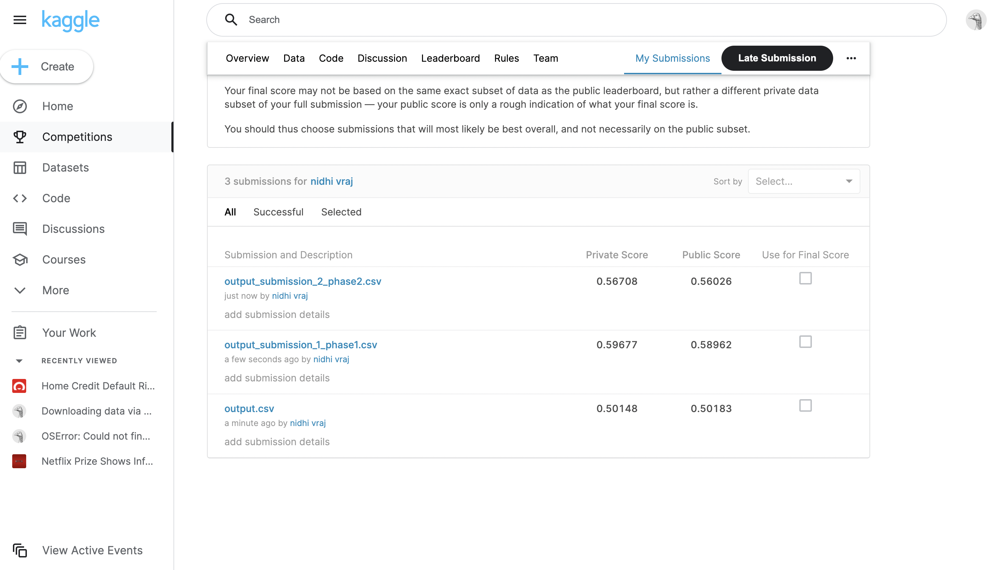

## report submission

Click on this [link](https://www.kaggle.com/c/home-credit-default-risk/submissions?sortBy=date&group=all&page=1)

# Write-up 
 
## Abstract
HomeCredit uses Machine Learning Modeling to provide unsecured loans based on a user's credit history, repayment behaviors, and other data. Our main goal is to see how accurately we can predict a new applicant's ability to repay loans. Credit history is a metric that explains a user's reliability based on factors such as the user's average/minimum/maximum balance, Bureau scores recorded, salary, and repayment practices. We used kaggle datasets to perform exploratory data analysis, develop machine learning pipelines, and evaluate models across many evaluation metrics for a model to be deployed as a part of this project. We have built a baseline logistic regression pipeline in Phase-1. We tested our baseline pipeline with a balanced dataset of 50000 non-defaulters, and a balanced dataset of 75000 non-defaulters. The test accuracy of the baseline pipeline turned out to be 91.9%, however the AUC score is only 0.5. After balancing the dataset for the 50000 non-defaulters dataset, we obtained a test accuracy of 71.4% and an AUC score of 0.62. The dataset of 75000 non-defaulters resulted in 76% test accuracy and 0.57 AUC score.
## Project Description
 #### Data Description
* application_{train|test}.csv <br>
 This is the main table, broken into two files for Train (with TARGET) and Test (without TARGET). Static data for all applications. One row represents one loan in our data sample. 
 
* POS_CASH_balance.csv <br>
This dataset gives information about previous credits information such as contract status, number of installments left to pay, DPD(days past due), etc. of the current application. Monthly balance snapshots of previous POS (point of sales) and cash loans that the applicant had with Home Credit. <br>

* bureau.csv <br>
All client's previous credits provided by other financial institutions were reported to the Credit Bureau (for clients who have a loan in our sample). For every loan in our sample, there are as many rows as the number of credits the client had in the Credit Bureau before the application date.

* bureau_balance.csv <br>
Monthly balances of previous credits in the Credit Bureau. This table has one row for each month of history of every previous credit reported to the Credit Bureau.

* credit_card_balance.csv <br>
Monthly balance snapshots of previous credit cards that the applicant has
with Home Credit. 

* previous_application.csv <br>
All previous applications for Home Credit loans of clients who have loans in our sample. There is one row for each previous application related to loans in our data sample.

* installments_payments.csv <br>
Repayment history for the previously disbursed credits in Home Credit related to the loans in our sample. There is a) one row for every payment that was made plus b) one row each for missed payment. One row is equivalent to one payment of one installment OR one installment corresponding to one payment of one previous Home Credit credit related to loans in our sample.

#### Task to be tackled:
Due to the size of this data collection, we will conduct EDA at this phase to determine whether characteristics of applicants are associated with a higher chance of default.

The most important task during this phase was Exploratory Data Analysis, but it was also important to figure out which parts of the data collection had missing values and to properly pre-process those variables using numerical encoding.

## Workflow

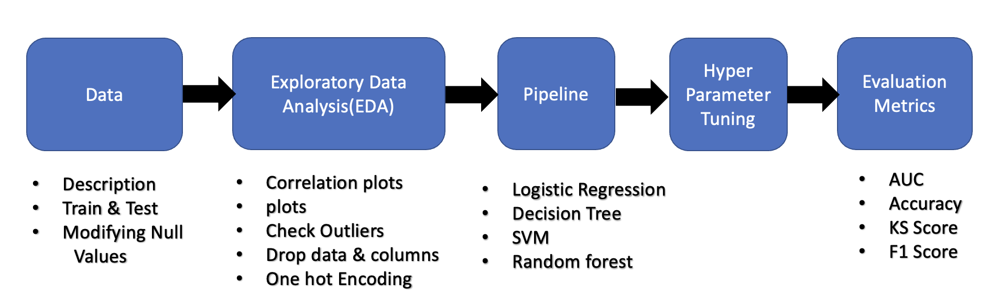




## Feature Engineering and transformers

By using Feature engineering we were able to increase the efficiency of the model by performing following tasks:

1) StandardScaler(): Before applying Machine Learning algorithms to the dataset, We have to carefully understand the magnitude of all key features, which is applicable for feature selection and finding independent and dependent variables. So we scaled them accordingly to accommodate for the analysis and model preparations. This scaling allowed us to limit the wide range of variables in the feature under the certain mathematical approach. We used StandardScaler builtin function to Standardize the features by subtracting the mean and then scaling to unit variance. Unit variance means dividing all the values by the standard deviation.

Scaling is an important approach that allows us to limit the wide range of variables in the feature under the certain mathematical approach.

2) One-hot encoding: we performed One Hot encoding whether to raise an error or ignore if an unknown categorical feature is present during transform (default is to raise). When this parameter is set to ‘ignore’ and an unknown category is encountered during transform, the resulting one-hot encoded columns for this feature will be all zeros. 


3) Handling Missing Values
Train dataset in application. csv
- Shape: (307511, 122)

In some datasets, we got the NA values in features. It is nothing but missing data. By handling this type of data there are many ways. The null count and percentage of the features of train dataset are as follows: 
 

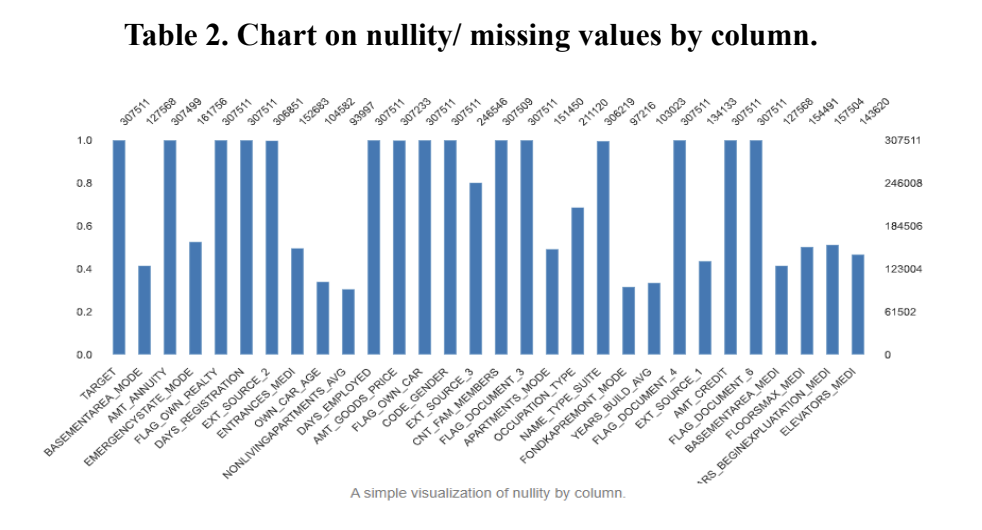

* Null values were eliminated and replaced. Infinite big values were also deleted.In the missing value places, we replaced the missing values with median to numerical data and for categorical data with mode. 
* We removed features with null values greater than 50% of the time.
* The total number of features after dropping is 121.


## One Hot Encoding

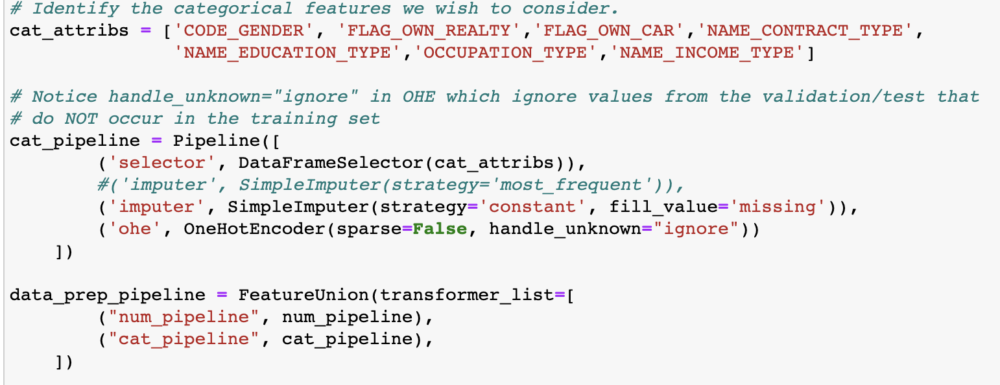

### Handling Missing Values

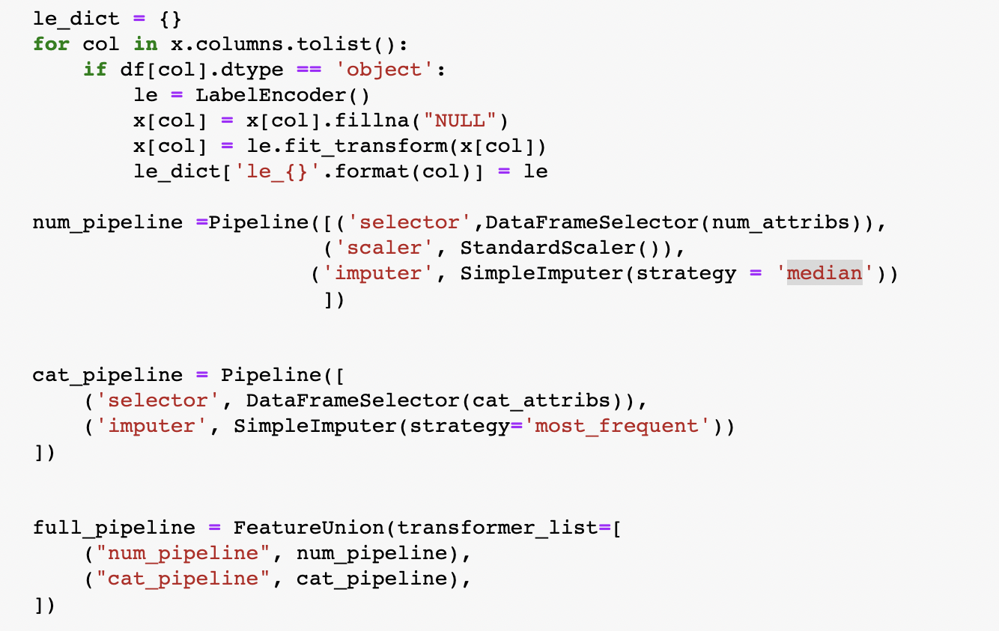

## Pipelines

The goal here is to predict whether the customer who has reached out to Home Credit for a loan is a defaulter or not. Therefore, this is a supervised classification task, and the output of the target variable is either 1 or 0 where 1 means non-defaulter and 0 means defaulter.

* We are planning to use the following algorithms in our machine learning pipeline.
1) Logistic Regression <br>
2) Decision Trees<br>
3) Random Forests<br>
4) Support Vector Machines (with different kernels like- linear, polynomial, radial basis function) <br>
5) Neural Networks (RNN, LSTM’S) <br>

● Logistic Regression can be used as a baseline model along with feature selection techniques like RFE,PCA, SelectKbest. <br>
● Support vector machine is a non-probabilistic binary classifier . It maps training examples to points in space so as to maximize the width of the gap between the two categories. It can also use the kernel trick to perform non linear classification, implicitly mapping the inputs into high dimensional feature space. <br>
● Random forests or random decision forests is an ensemble learning method that operates by constructing a multitude of decision trees at training time. For classification tasks, the output of the random forest is the class selected by most trees. <br>
● LightGBM is a fast, distributed, high performance gradient boosting framework based on decision tree algorithms which can be used for classification. <br>
● Deep learning neural networks may be used to improve the prediction model's accuracy, but we wouldn't be able to give the attributes that determine whether or not a client is a defaulter. This would lead to compliance concerns, as we would need to provide the specific features that would cause the loan to be rejected for the likely non-defaulters. <br>

### Machine Learning Pipeline Steps:
1. Data Preprocessing <br>
a. Gather Kaggle's raw data.<br>
b. Perform exploratory data analysis on the dataset.<br>
c. Feature engineering for improving performance of machine learning model.<br>
2. Model Selection<br>
a. Develop and test various candidate models, such as "Logistic Regression","Decision Making Trees", "Random Forest", and "SVMs. <br>
b. Based on the evaluation measures, select the best model.<br>
c. Use various evaluation metrics like "accuracy," "F1 Score," and "AUC."<br>
3. Prediction Generation<br>
a. Prepare the new data and extract the features as before.<br>
b. Once the winning model has been chosen, use it to make predictions on the new data.


### Baseline Logistic Regression Pipeline - 
- First, we partition the data into train and test. For correct findings, we separated 20% of the test data with a random seed set to 42.
- Next, we developed a logistic regression baseline pipeline. Based on numerical properties and a standard scaler, we create a numerical pipeline. We use the median to fill in the blanks. With this numeric pipeline, we perform a logistic regression.
- Finally, using 30 splits and a test size of 0.3, we generate cross validation splits. We use cross validation to calculate test accuracy and AUC.

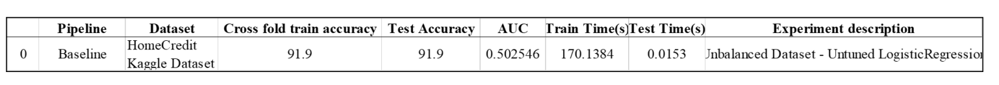

The above Table reports test accuracy and AUC of the logistic regression baseline results. The AUC is 0.502546. The test accuracy is 91.9.


4. Improving AUC
(a) 50000 non-defaulters Balanced Dataset
- To improve the AUC, we check across the test dataset and balance the dataset. The below table represents the first five rows and ten columns of the test dataset.

- The value count of 0 in the target dataset is 282686, while the value count of 1 is 24825.
- In the target dataset, we balance the dataset by appending the values 1 and 0.
- e-build 50000 Balanced Dataset.
- We split the data into train and test using 20% test data and a random seed of 42.
- The train X dataset has a 59860 by 121 matrix, while the train Y dataset has a 59860 row matrix. 



#### Test Dataset

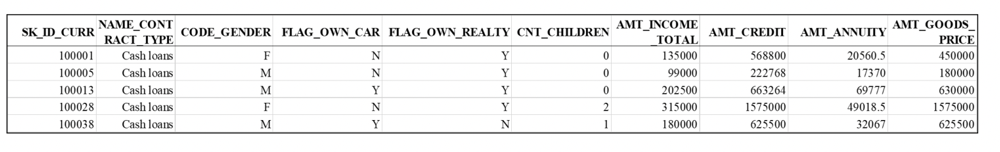

- The results for the baseline and balanced datasets are shown in the below table. The findings for the balanced dataset are found in the newly added second row.

#### 50000 non-defaulters Balanced dataset
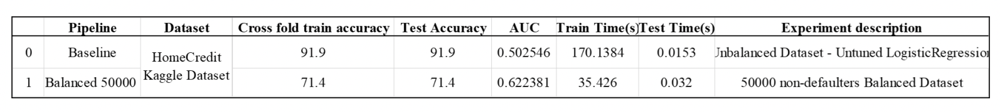

 
- The AUC for 50000 non-defaulters balanced dataset is 0.62. The test accuracy is 71.4.

(b) 75000 non-defaulters Balanced Dataset
- Here we use an alternative approach to balance the dataset. We append the values of 1 and 0 in the target dataset and this time we build 75000 non-defaulters Balanced Dataset.
- In the 75000 non-defaulters balanced dataset, the train X dataset is a shape of 79860 by 121 matrix, and train Y dataset is a shape of 79860 row matrix.

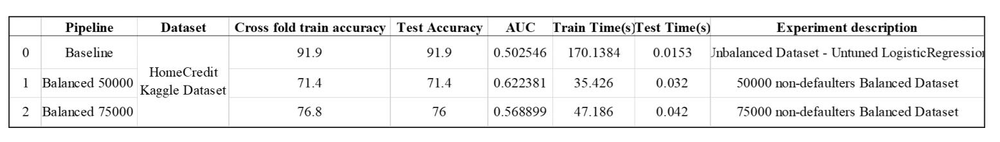

- The AUC for 75000 non-defaulters balanced dataset is 0.57. The test accuracy is 76.

### Baseline logistic regression code:

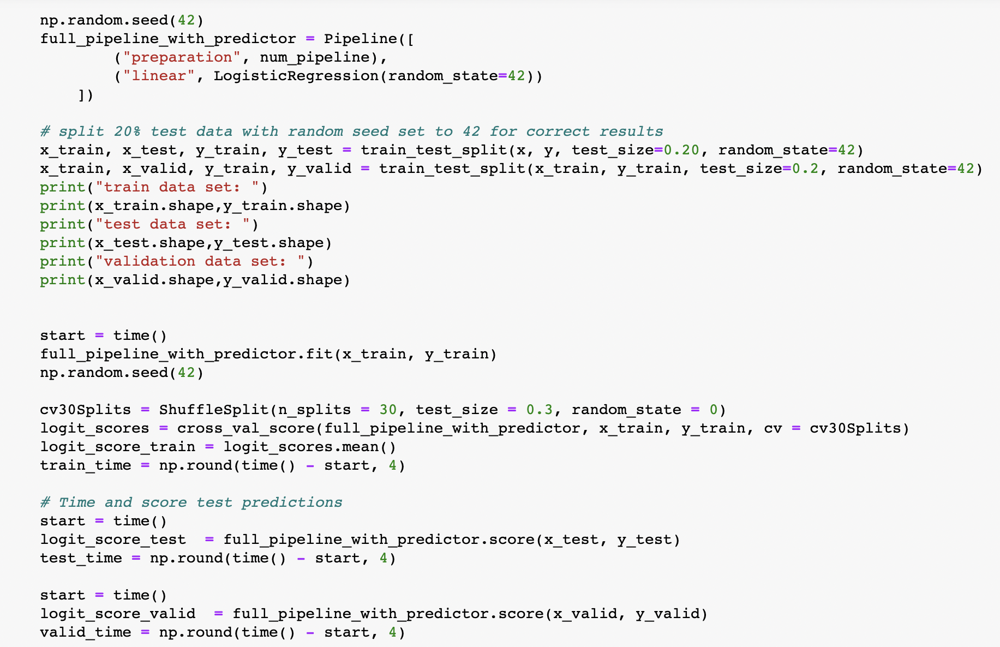

## Experimental results and Discussions
* The test accuracy and AUC of the logistic regression baseline findings, rebalancing dataset of 50000 non-defaulters, and rebalancing dataset of 75000 non-defaulters, respectively, are reported in the above tables. The AUC for the logistic regression baseline pipeline is 0.502546, with a test accuracy of 91.9. The AUC is 0.62 and the test accuracy is 71.4 after rebalancing the 50000 non-defaulters balanced dataset. As a result, by re-balancing, we can gain a better AUC while sacrificing test accuracy. We enhance explanatory power of the test set by increasing the sample size of non-defaulters.

* Prior to rebalancing, the baseline model had the highest test accuracy but the lowest AUC. As a result, we rebalanced the dataset in different sample sizes in an attempt to enhance the AUC. Our goal was to create a model with similar test accuracy to the baseline model but a higher AUC, because AUC measures the quality of the model's predictions. We have room to improve with other potential models because this is a baseline model without feature engineering or hyper-parameter adjustment.

* Our baseline model has a high level of test accuracy but a poor AUC. When it comes to improving AUC, re-balancing is beneficial, but it comes at the expense of accuracy. We believe that other candidate models, such as hyper-parameter adjustment and extra feature engineering, could help to enhance AUC while also boosting test accuracy.


## Conclusion

The goal of the HCDR initiative is to forecast the ability of the financially underserved population to repay loans. This project is significant because both the lender and the borrower require well-established predictions. Homecredit can present loan offers with the highest amount and APR to its consumers in real time thanks using ML pipelines, which acquire data from data providers via APIs, run EDA, and fit it to the model to generate scores in microseconds. As a result, risk analysis becomes extremely important in this situation, because NPA (Non-Performing Asset) is expected to be less than 5% in order to run a profitable firm. <br>

Credit history is a measure of a user's credibility that is calculated using characteristics such as the user's average/minimum/maximum balance, Bureau scores reported, salary, and repayment patterns that may be analyzed using the user's past timely defaults/repayments. Other criteria such as location data, social media data, calling/SMS data, and so on are included in alternate data. We would use the datasets given by kaggle for exploratory data analysis, machine learning pipelines, and model evaluation across many evaluation metrics for a model to be deployed as a part of this project. <br>

Our EDA analysis reveals the target dataset's features. We compare the gender differences, income differences, whether they own a home or a car, and the data's jobs in target and non-target groups. Our findings show that women outnumber males among borrowers and targeted. Men earn more money than women. More people own houses than people who do not own houses. More people own cars than people who do not own cars. <br>

We give baseline logistic regression pipelines in Phase-1. We tested a baseline pipeline, a balanced dataset of 50000 non-defaulters, and a balanced dataset of 75000 non-defaulters. The test accuracy of a baseline pipeline is 91.9%, however the AUC is only 0.5%. After rebalancing the dataset, the 50000 non-defaulters dataset has a test accuracy of 71.4% and an AUC score of 0.62. The 75000 non-defaulters dataset demonstrates 76% test accuracy and 0.57 AUC after increasing the sample size. As a result of our findings, we gain a greater AUC but lose test accuracy by re-balancing. These regressions suggest that there is a tradeoff between AUC and test accuracy, and that researchers should carefully decide which to improve. <br>

We believe that we should explore alternative candidate models in the future because these are baseline models without feature engineering or hyper-parameter adjustment. That is, we would examine more feature engineering, hyper-parameter tuning, feature selection and importance, and ensemble approaches in Phase 2. These additional strategies should help to enhance the models' AUC and test accuracy. <br>

## Kaggle Submission
Our output dataset on the target has 45673 values of 0, and 3071 values of 1.
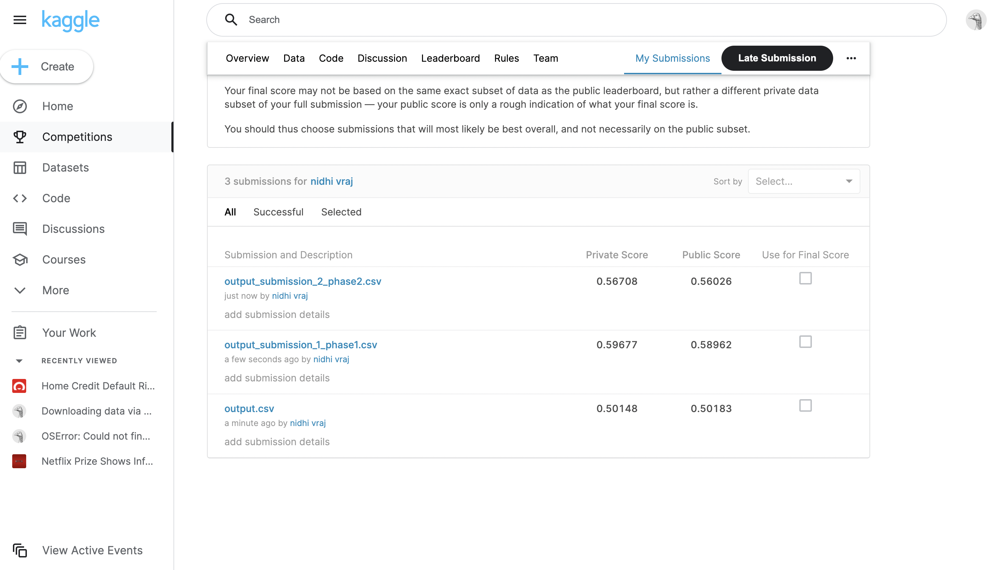

# References

Some of the material in this notebook has been adopted from [here](https://www.kaggle.com/willkoehrsen/start-here-a-gentle-introduction/notebook)

https://towardsdatascience.com/building-a-logistic-regression-in-python-step-by-step-becd4d56c9c8

https://online.stat.psu.edu/stat857/node/216/

#  TODO: Predicting Loan Repayment with Automated Feature Engineering in Featuretools

Read the following:
* feature engineering via Featuretools library: 
  * https://github.com/Featuretools/predict-loan-repayment/blob/master/Automated%20Loan%20Repayment.ipynb
* https://www.analyticsvidhya.com/blog/2018/08/guide-automated-feature-engineering-featuretools-python/
* feature engineering paper: https://dai.lids.mit.edu/wp-content/uploads/2017/10/DSAA_DSM_2015.pdf
* https://www.analyticsvidhya.com/blog/2017/08/catboost-automated-categorical-data/